# Baker 2015 stereo-lidar collected data notebook
* get filtered lidar point cloud for coregistration surfaces
* look at dataset train/val split & individual tiles visualization
* start to evaluate model refined output differences based on NLCD land cover class

## Imports

In [1]:
import rasterio
import pdal

import pathlib

from osgeo import gdal
import json

import os
import rioxarray

import shapely.geometry

import numpy as np
import subprocess
import json
from rasterio import features
import pyproj
from shapely.ops import transform

import shapely

import geopandas as gpd
import matplotlib.pyplot as plt


In [69]:
root_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/"

In [1]:
tile_metadata_dir = "tile_metadata"

## Header

In [6]:
!gdalinfo $ortho_left_path

Driver: GTiff/GeoTIFF
Files: /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_east_half_baker_mapproject_w_3dep_refdem/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8795_LAS_2017/lower_easton3/files_to_zip/1020010042D39D00.r100_ortho_1.0m_ba.tif
Size is 949, 949
Coordinate System is:
PROJCRS["WGS 84 / UTM zone 10N",
    BASEGEOGCRS["WGS 84",
        DATUM["World Geodetic System 1984",
            ELLIPSOID["WGS 84",6378137,298.257223563,
                LENGTHUNIT["metre",1]]],
        PRIMEM["Greenwich",0,
            ANGLEUNIT["degree",0.0174532925199433]],
        ID["EPSG",4326]],
    CONVERSION["UTM zone 10N",
        METHOD["Transverse Mercator",
            ID["EPSG",9807]],
        PARAMETER["Latitude of natural origin",0,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8801]],
        PARAMETER["Longitude of natural origin",-123,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8802]],
        PARAMETER["Scal

In [7]:
minx, miny = 587100, 5395100
maxx, maxy = minx+256, miny + 256

In [372]:
tile_ids = []
for s in pathlib.Path(input_dir).glob("*"):
    # print(os.path.basename(s))
    tile_id = str(s)[-18:-9]
    tile_ids.append(tile_id)

In [164]:
tile_id = "10UEU8795"
# tile_id = tile_ids[10] # 10UEV8407 also good example
tile_id = tile_ids[8]
tile_folder = f"pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017"
input_dir = f"{root_dir}/{tile_folder}/lower_easton3/files_to_zip/"
# Mapproject with 3DEP refdem still had ortho holes in tile_id 10UEU8795

## Load nodata masks

In [166]:

ortho_left_fn = "1020010042D39D00.r100_ortho_1.0m_ba.tif"
ortho_left_path = os.path.join(input_dir, ortho_left_fn)


# json.loads(
# 'cornerCoordinates': {'upperLeft': [587024.5, 5395974.5],
#   'lowerLeft': [587024.5, 5395025.5],
#   'lowerRight': [587973.5, 5395025.5],
#   'upperRight': [587973.5, 5395974.5],
#   'center': [587499.0, 5395500.0]},
minx, miny = gdal.Info(ortho_left_path, options=["-json"])["cornerCoordinates"]["lowerLeft"]
maxx, maxy = gdal.Info(ortho_left_path, options=["-json"])["cornerCoordinates"]["upperRight"]

print("Actual bounds", minx, miny, maxx, maxy)
# Observe the different behavior from mapproject compared to point2dem/pdal bounds 587024.5 5395025.5 587973.5 5395974.5

minx += 5
miny += 5
maxx, maxy = minx+900, miny +900
print("Patch for testing", minx, miny, maxx, maxy)


Actual bounds 584024.5 5397025.5 584973.5 5397974.5
Patch for testing 584029.5 5397030.5 584929.5 5397930.5


In [167]:


# Get minx bounds

with rasterio.open(ortho_left_path) as olf:
    mask_left = olf.read_masks(1, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, olf.transform))
    ortho_left = olf.read(1, masked=True, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, olf.transform))
print(mask_left.shape)
print(ortho_left.shape)

(900, 900)
(900, 900)


In [168]:
ortho_right_fn = "1020010043455300.r100_ortho_1.0m_ba.tif"
ortho_right_path = os.path.join(input_dir, ortho_right_fn)
with rasterio.open(ortho_right_path) as orf:
    mask_right = orf.read_masks(1, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, orf.transform))
    ortho_right = orf.read(1, masked=True, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, orf.transform))
print(mask_right.shape)
print(ortho_right.shape)

(900, 900)
(900, 900)


In [169]:
dem_with_holes_fn = "pc_align_tr-trans_source_1.0m-DEM.tif"
dem_with_holes_path = os.path.join(input_dir, dem_with_holes_fn)
                                   
with rasterio.open(dem_with_holes_path) as demf:
    mask_dem = demf.read_masks(1, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, demf.transform))
    dem_holes = demf.read(1, masked=True, window=rasterio.windows.from_bounds(minx, miny, maxx, maxy, demf.transform))
# TODO this should be separate from loading the interpolated DEM (hole_fill.py) as we want to have those precomputed...
print(mask_dem.shape)
print(dem_holes.shape)

(900, 900)
(900, 900)


In [255]:
# !find $root_dir -name "*first_filt_v1.3.laz" -type f -mtime -1 -ls
# !ls -l /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017_32610_first_filt_v1.3.laz 
# !cp /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8697_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8697_LAS_2017_32610_first_filt_v1.3.laz /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8697_LAS_2017/lower_easton3/files_to_zip/USGS_LPC_WA_MtBaker_2015_10UEU8697_LAS_2017_32610_first_filt_v1.3.laz
# !cp /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017_32610_first_filt_v1.3.laz /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017/lower_easton3/files_to_zip/USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017_32610_first_filt_v1.3.laz
# last_tile = tiles[-1]
# !ls -l $last_tile

In [260]:
num_tiles = 64
tiles = list(str(p) for p in pathlib.Path(root_dir).glob("**/files_to_zip/*first_filt_v1.3.laz"))[:num_tiles]
tiles_str = " ".join(tiles)

In [263]:
!gdalinfo "/mnt/1.0_TB_VOLUME/sethv/data/nlcd_2016_land_cover_l48_20210604.tif"

Driver: GTiff/GeoTIFF
Files: /mnt/1.0_TB_VOLUME/sethv/data/nlcd_2016_land_cover_l48_20210604.tif
Size is 161190, 104424
Coordinate System is:
PROJCRS["Albers Conical Equal Area",
    BASEGEOGCRS["WGS 84",
        DATUM["World Geodetic System 1984",
            ELLIPSOID["WGS 84",6378137,298.257223563,
                LENGTHUNIT["metre",1]]],
        PRIMEM["Greenwich",0,
            ANGLEUNIT["degree",0.0174532925199433]],
        ID["EPSG",4326]],
    CONVERSION["Albers Equal Area",
        METHOD["Albers Equal Area",
            ID["EPSG",9822]],
        PARAMETER["Latitude of false origin",23,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8821]],
        PARAMETER["Longitude of false origin",-96,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8822]],
        PARAMETER["Latitude of 1st standard parallel",29.5,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8823]],
        PARAMETER["Latitude of 2nd stan

## PDAL merge

In [261]:
%%timeit -n 1 -r 1
out_fn = f"west_half_merged{num_tiles}.laz"
!pdal merge $tiles_str $out_fn
!ls -l $out_fn

-rw-rw-r-- 1 sethv sethv 7608144626 Nov  2 18:07 west_half_merged64.laz
48min 6s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


## Loading laz

In [70]:
laz_sizes = []
laz_files = []
for fn in list(pathlib.Path(root_dir).glob("**/files_to_zip/*first_filt_v1.3.laz")):
    laz_sizes.append(os.path.getsize(fn))
    laz_files.append(str(fn))

In [71]:
len(laz_sizes)

64

In [72]:
sum(laz_sizes) / (10**9) # size in GB , we expect the merged tiles to equal this in size

7.600718263

In [375]:
project = pyproj.Transformer.from_proj(
    pyproj.Proj(init='epsg:32610'), # source coordinate system
    pyproj.Proj(init='epsg:9001')) # destination coordinate system

baker_box_with_extra_9001 = transform(project.transform, baker_box_with_extra_32610)  # apply projection

/mnt/1.0_TB_VOLUME/sethv/miniconda3/envs/der/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/mnt/1.0_TB_VOLUME/sethv/miniconda3/envs/der/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [376]:
baker_box_with_extra_9001.area / (1000**2)

415.9526899384872

In [377]:
# nlcd2016.rio.crs

CRS.from_wkt('PROJCS["Albers Conical Equal Area",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Albers_Conic_Equal_Area"],PARAMETER["latitude_of_center",23],PARAMETER["longitude_of_center",-96],PARAMETER["standard_parallel_1",29.5],PARAMETER["standard_parallel_2",45.5],PARAMETER["false_easting",0],PARAMETER["false_northing",0],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]')

In [89]:

# fury_box = shapely.geometry.box(fury_minx, fury_miny, fury_maxx, fury_maxy)
# Baker extent in EPSG:32610
# Upper Left  (  572962.939, 5414452.066) (122d 0'17.50"W, 48d52'43.42"N)
# Lower Left  (  572962.939, 5386060.437) (122d 0'35.62"W, 48d37'24.08"N)
# Upper Right (  592244.837, 5414452.066) (121d44'30.97"W, 48d52'34.17"N)
# Lower Right (  592244.837, 5386060.437) (121d44'53.87"W, 48d37'14.91"N)
baker_minx, baker_miny, baker_maxx, baker_maxy = 572900, 5386000, 592300, 5414500
baker_box_with_extra_32610 = shapely.geometry.box(baker_minx, baker_miny, baker_maxx, baker_maxy)
baker_box_with_extra_32610.area / (1000**2)

nlcd2016 = rioxarray.open_rasterio("/mnt/1.0_TB_VOLUME/sethv/data/nlcd_2016_land_cover_l48_20210604.tif")
# nlcd2016 = nlcd2016.rio.clip(baker_box_with_extra)
nlcd2016_baker = nlcd2016.rio.clip_box(baker_minx, baker_miny, baker_maxx, baker_maxy, crs="EPSG:32610")

nlcd2016_baker_32610 = nlcd2016_baker.rio.reproject("EPSG:32610")

In [90]:
nlcd2016_baker_32610.rio.to_raster("nlcd2016_baker_32610.tif")

In [379]:
nlcd2016_baker.min(), nlcd2016_baker.max()

(<xarray.DataArray ()>
 array(11, dtype=uint8)
 Coordinates:
     spatial_ref  int64 0,
 <xarray.DataArray ()>
 array(95, dtype=uint8)
 Coordinates:
     spatial_ref  int64 0)

In [ ]:
baker_nlcd_rock_mask = (nlcd2016_baker == 31)
# fig, ax= plt.subplots(1,1,figsize=(20,20))
baker_nlcd_rock_mask.plot()#ax=ax)
plt.title("Baker NLCD 2016 class 31")

In [120]:
!gdal_translate -tr 30 30 /mnt/1.0_TB_VOLUME/sethv/resdepth_all/data/baker_2015_utm_m.tif baker_2015_utm_m_30m.tif


Input file size is 21107, 31079
0...10...20...30...40...50...60...70...80...90...100 - done.


In [122]:
!dem_mask.py --glaciers --nlcd --nlcd_filter rock baker_2015_utm_m_30m.tif

baker_2015_utm_m_30m.tif
467529 valid pixels in original input tif
Masking glaciers
Found glacier shp: /mnt/1.0_TB_VOLUME/sethv/data/rgi60/regions/rgi60_merge.shp
Input shp srs: +proj=longlat +datum=WGS84 +no_defs
Specified output srs: +proj=utm +zone=10 +datum=WGS84 +units=m +no_defs

Warping all inputs to the following:
Resolution: 30.0
Extent: [572962.9387119232, 5386072.066348841, 592252.9387119232, 5414452.066348841]
Projection: '+proj=utm +zone=10 +datum=WGS84 +units=m +no_defs'
Resampling alg: near

1 of 1: /mnt/1.0_TB_VOLUME/sethv/data/nlcd_2016_land_cover_l48_20210604.tif
nl: 946 ns: 643 res: 30.000
0...10...20...30...40...50...60...70...80...90...100 - done.
Loading NLCD LULC
Filtering NLCD LULC with: rock
Generating final mask to use for reference surfaces, and applying to input DEM
41724 valid pixels in masked output tif to be used as ref
331.57 std in masked output tif to be used as ref
Writing out /mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/to

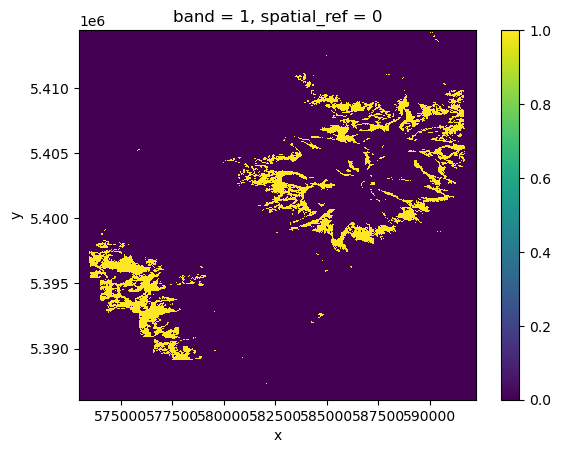

In [148]:
(dem_mask_nlcd_rock_excludes_glacier > 0).plot()

In [218]:
len(shapes) # 5m dem_mask tif = 1504715 shapes... excessive. 30m resolution from NLCD direct gives 785. 30m res from dem_mask is 42113

41716

In [20]:
# gdf = gpd.read_file("nlcd2016_baker_32610_class_31_polygons.shp")
# gdf.to_file("nlcd2016_baker_32610_class_31_polygons.shp") # save as shapefile

## PDAL pipeline to filter out all points in cloud that are not rock class

Extracting pdal info --metadata (fast)...
586000 5399000 586999.99 5399999.99


<AxesSubplot:>

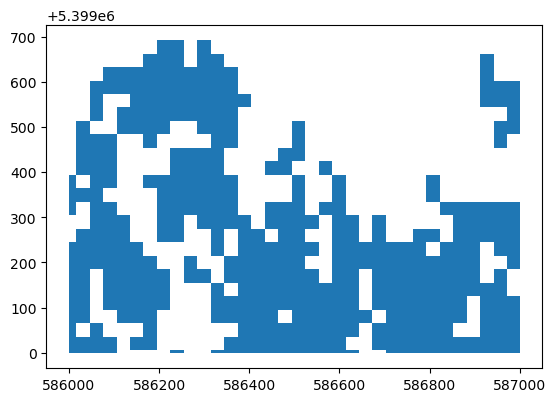

In [73]:
# trim the polygons to only be within THIS tile

# first extract PDAL bounds
print("Extracting pdal info --metadata (fast)...")
result = subprocess.run(
    ["pdal", "info", "--metadata", laz_input_fn],
    stderr=subprocess.PIPE,  # stderr and stdout get
    stdout=subprocess.PIPE,
)  # captured as bytestrings

# decode stdout from bytestring and convert to a dictionary
json_result = json.loads(result.stdout.decode())
# print(json_result["metadata"])

# NOTE check against initial DEM/orthos extent should happen when generating tile list

# TODO bbox will fail for uneven tiles at the edges, if there are any that overlap with
minx, miny, maxx, maxy = (json_result["metadata"][f] for f in ["minx", "miny", "maxx", "maxy"])
# bbox = json_result["stats"]["bbox"]["native"]["bbox"]
# print(bbox)

# ulx, uly, lrx, lry = bbox["minx"], bbox["maxy"], bbox["maxx"], bbox["miny"]
# xmin, ymin, xmax, ymax = bbox["minx"], bbox["miny"], bbox["maxx"], bbox["maxy"]

print(minx, miny, maxx, maxy)

tile_box = shapely.geometry.box(minx, miny, maxx, maxy)
polygons_for_tile = gdf.clip(tile_box)
polygons_for_tile.plot()

### Define mask using NLCD only

In [155]:

mask = (nlcd2016_baker_32610 == 31)
shapes = features.shapes(nlcd2016_baker_32610, mask=mask, transform=nlcd2016_baker_32610.rio.transform())
shapes = list(shape[0] for shape in shapes) 
print(f"{len(shapes)} polygons for this NLCD class in the raster")
gdf = gpd.GeoDataFrame(geometry=[shapely.geometry.shape(s) for s in shapes], crs="EPSG:32610")

785 polygons for this NLCD class in the raster


### Pretty picture when define & extract mask with DEM_mask (glaciers, NLCD rock)

616 {'type': 'Feature', 'id': 'baker_2015_utm_m_30m_ref.tif:0', 'properties': {'val': 255.0, 'filename': 'baker_2015_utm_m_30m_ref.tif'}, 'bbox': [590032.9387119232, 5414242.066348841, 590062.9387119232, 5414272.066348841], 'geometry': {'type': 'Polygon', 'coordinates': [[(590032.9387119232, 5414272.066348841), (590032.9387119232, 5414242.066348841), (590062.9387119232, 5414242.066348841), (590062.9387119232, 5414272.066348841), (590032.9387119232, 5414272.066348841)]]}}


<AxesSubplot:>

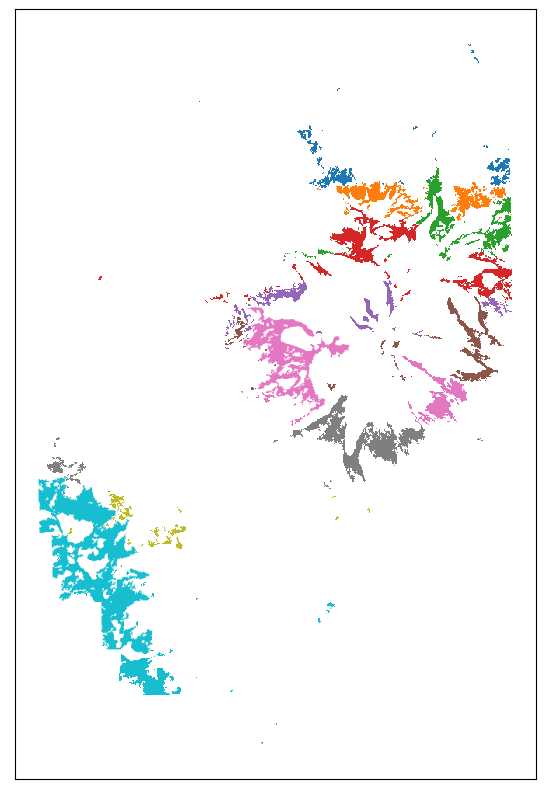

In [6]:
with rasterio.open("baker_2015_utm_m_30m_ref.tif") as mask_src:
    # mask_ds = mask_file.read()
    polygons = list(rasterio.features.dataset_features(
        mask_src,
        band=False,
        as_mask=True,
        geographic=False
    ))
    print(len(polygons), polygons[0])
gdf = gpd.GeoDataFrame(geometry=[shapely.geometry.shape(p["geometry"]) for p in polygons], crs="EPSG:32610")
gdf["c"] = gdf.index
fig, ax = plt.subplots(figsize=(10,10))
ax.set_xticks([])
ax.set_yticks([])
gdf.plot(ax=ax, column="c", cmap="tab10")

In [ ]:
# # !dem_mask.py --glaciers --nlcd --nlcd_filter rock baker_2015_utm_m_30m.tif
# mask_tif_path = "baker_2015_utm_m_30m_ref.tif"
# dem_mask_nlcd_rock_excludes_glacier = rioxarray.open_rasterio(mask_tif_path, masked=True)
# from rasterio import CRS
# assert dem_mask_nlcd_rock_excludes_glacier.rio.crs == CRS.from_epsg(32610)

# shapes = features.shapes(
#     dem_mask_nlcd_rock_excludes_glacier,
#     mask=(dem_mask_nlcd_rock_excludes_glacier > 0),
#     transform=dem_mask_nlcd_rock_excludes_glacier.rio.transform()
# ) # no `mask` as dem_mask outputs elevations, not land cover classes
# shapes = list(shape[0] for shape in shapes) 
# print(f"{len(shapes)} polygons for dem_mask raster")

# gdf = gpd.GeoDataFrame(geometry=[shapely.geometry.shape(s) for s in shapes], crs="EPSG:32610")


In [214]:
list_of_tile_gdfs = []
for laz_input_fn in laz_files:#[:10]:
    import time
    start = time.time()
    laz_file_without_extension = os.path.basename(laz_input_fn)[:-4]
    # filtered_laz_fn = f"{filtered_dir}/{laz_file_without_extension}_filtered.laz"
    
    # trim the polygons to only be within THIS tile

    # print(f"Extracting bbox with {command}")
    result = subprocess.run(
        ["pdal", "info", "--metadata", laz_input_fn],
        stderr=subprocess.PIPE,  # stderr and stdout get
        stdout=subprocess.PIPE,
    )  # captured as bytestrings

    # decode stdout from bytestring and convert to a dictionary
    json_result = json.loads(result.stdout.decode())
    # print(json_result["metadata"])

    # NOTE check against initial DEM/orthos extent should happen when generating tile list

    # TODO bbox will fail for uneven tiles at the edges, if there are any that overlap with
    minx, miny, maxx, maxy = (json_result["metadata"][f] for f in ["minx", "miny", "maxx", "maxy"])
    # bbox = json_result["stats"]["bbox"]["native"]["bbox"]
    # print(bbox)

    # ulx, uly, lrx, lry = bbox["minx"], bbox["maxy"], bbox["maxx"], bbox["miny"]
    # xmin, ymin, xmax, ymax = bbox["minx"], bbox["miny"], bbox["maxx"], bbox["maxy"]

    # print(minx, miny, maxx, maxy)

    tile_box = shapely.geometry.box(minx, miny, maxx, maxy)
    polygons_for_tile = gdf.clip(tile_box)
    list_of_tile_gdfs.append(polygons_for_tile)
    print(f"Found {len(polygons_for_tile)} different mask polygons within this tile")
    polygon_list = list(polygons_for_tile.to_wkt().geometry)
    # polygons_for_tile.plot()

Found 3 different mask polygons within this tile
Found 8 different mask polygons within this tile
Found 5 different mask polygons within this tile
Found 1 different mask polygons within this tile
Found 0 different mask polygons within this tile
Found 4 different mask polygons within this tile
Found 4 different mask polygons within this tile
Found 0 different mask polygons within this tile
Found 4 different mask polygons within this tile
Found 6 different mask polygons within this tile
Found 0 different mask polygons within this tile
Found 17 different mask polygons within this tile
Found 4 different mask polygons within this tile
Found 2 different mask polygons within this tile
Found 1 different mask polygons within this tile
Found 0 different mask polygons within this tile
Found 1 different mask polygons within this tile
Found 4 different mask polygons within this tile
Found 0 different mask polygons within this tile
Found 3 different mask polygons within this tile
Found 0 different m

## Run the PDAL filtering

In [215]:
# !rm -rf usgs_laz_filtered_dem_mask_nlcd_rock_exclude_glaciers

### For each tile, get the bare ground contained in it, and run PDAL point cloud filter to crop all points that aren't bare ground

In [217]:
filtered_dir = "usgs_laz_filtered_dem_mask_nlcd_rock_exclude_glaciers"
plots_dir = os.path.join(filtered_dir, "plots")
os.makedirs(filtered_dir, exist_ok=True)
os.makedirs(plots_dir, exist_ok=True)
list_of_tile_gdfs = []
for laz_input_fn in laz_files:
    import time
    start = time.time()
    laz_file_without_extension = os.path.basename(laz_input_fn)[:-4]
    filtered_laz_fn = f"{filtered_dir}/{laz_file_without_extension}_filtered.laz"
    
    # trim the polygons to only be within THIS tile

    # first extract PDAL bounds
    command = ["pdal", "info", "--metadata", laz_input_fn]
    
    print(f"\n***Filtering tile {laz_file_without_extension}...")
    !du -sh $laz_input_fn

    # print(f"Extracting bbox with {command}")
    result = subprocess.run(
        ["pdal", "info", "--metadata", laz_input_fn],
        stderr=subprocess.PIPE,  # stderr and stdout get
        stdout=subprocess.PIPE,
    )  # captured as bytestrings

    # decode stdout from bytestring and convert to a dictionary
    json_result = json.loads(result.stdout.decode())
    # print(json_result["metadata"])

    # NOTE check against initial DEM/orthos extent should happen when generating tile list

    # TODO bbox will fail for uneven tiles at the edges, if there are any that overlap with
    minx, miny, maxx, maxy = (json_result["metadata"][f] for f in ["minx", "miny", "maxx", "maxy"])
    # bbox = json_result["stats"]["bbox"]["native"]["bbox"]
    # print(bbox)

    # ulx, uly, lrx, lry = bbox["minx"], bbox["maxy"], bbox["maxx"], bbox["miny"]
    # xmin, ymin, xmax, ymax = bbox["minx"], bbox["miny"], bbox["maxx"], bbox["maxy"]

    # print(minx, miny, maxx, maxy)

    tile_box = shapely.geometry.box(minx, miny, maxx, maxy)
    polygons_for_tile = gdf.clip(tile_box)
    list_of_tile_gdfs.append(polygons_for_tile)
    if len(polygons_for_tile) == 0:
        pass # could skip but creates confusion if fewer filtered .laz files than inputs
        # print("No polygons, skipping")
        # continue
    print(f"Found {len(polygons_for_tile)} different mask polygons within this tile")
    polygon_list = list(polygons_for_tile.to_wkt().geometry)
    
    pipeline = [
        laz_input_fn,
        {
            "type":"filters.crop",
            "polygon":polygon_list
        },
        {
            "type":"writers.las",
            "filename":filtered_laz_fn,
            "compression": "true"
        }
    ]

    pipeline_fn = f"pdal_filter_crop_{laz_file_without_extension}.json"
    with open(pipeline_fn,"w") as of:
        json.dump(pipeline, of)
    print("Running pdal filter pipeline")
    plot_mask = False
    if plot_mask:
        polygons_for_tile.plot()
        plt.savefig(os.path.join(plots_dir, f"mask_{laz_file_without_extension}.png"))
    # plt.show()
    if not os.path.exists(filtered_laz_fn):
        !pdal pipeline filter_pipeline.json
    print("output file:")
    !du -sh $filtered_laz_fn
    print(f"Processing time for tile {laz_file_without_extension}: {time.time() - start} seconds")



***Filtering tile USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017_32610_first_filt_v1.3...
115M	/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017/lower_easton3/files_to_zip/USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017_32610_first_filt_v1.3.laz
Found 3 different mask polygons within this tile
Running pdal filter pipeline
output file:
38M	usgs_laz_filtered_dem_mask_nlcd_rock_exclude_glaciers/USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017_32610_first_filt_v1.3_filtered.laz
Processing time for tile USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017_32610_first_filt_v1.3: 1.2096765041351318 seconds

***Filtering tile USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017_32610_first_filt_v1.3...
178M	/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8507_LAS_2017/lower_easton3/fi

In [65]:
fig, ax = plt.subplots(1, len(list_of_tile_gdfs))
for gdf_subset in list_of_tile_gdfs:
    gdf_subset.plot(ax=ax)

NameError: name 'list_of_tile_gdfs' is not defined

Text(0.5, 1.0, 'Baker NLCD 2016 class 31')

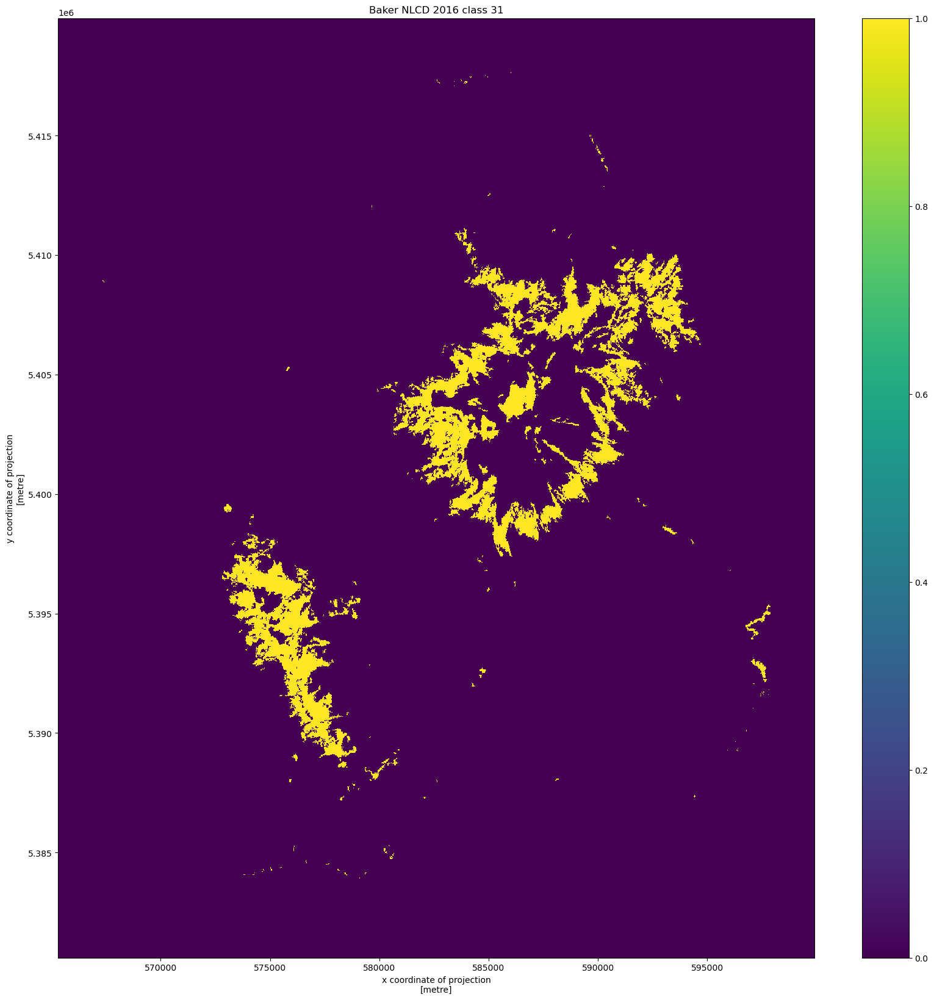

In [460]:
baker_nlcd_rock_mask = (nlcd2016_baker_32610 == 31)
fig, ax= plt.subplots(1,1,figsize=(15,15))
baker_nlcd_rock_mask.plot(ax=ax)
plt.title("Baker NLCD 2016 class 31")

In [453]:
baker_nlcd_rock_mask.size * (30**2) / (1000**2)

1371.5352

In [449]:
baker_nlcd_rock_mask.sum() * (30**2) / (1000**2)

<xarray.DataArray ()>
array(57.7854)
Coordinates:
    spatial_ref  int64 0

In [447]:
baker_nlcd_rock_mask.rio.resolution()

(29.87737287398153, -29.87737287398153)

In [384]:
baker_nlcd_rock_mask.sel(x=581652, y=5385808,method="nearest").values

array([False])

In [385]:
gdf["nlcd2016"] = gdf.centroid.apply(lambda p: nlcd2016_baker_32610.sel(x=p.x, y=p.y, method="nearest").values[0])

In [400]:
shapely.geometry.box?

Signature: shapely.geometry.box(minx, miny, maxx, maxy, ccw=True)
Docstring: Returns a rectangular polygon with configurable normal vector
File:      /mnt/1.0_TB_VOLUME/sethv/miniconda3/envs/der/lib/python3.10/site-packages/shapely/geometry/geo.py
Type:      function


In [404]:
tile0_polygon = gdf.geometry.iloc[0]
# print(type(tile0_polygon), tile0_polygon)
# tile0_polygon = [ {'type': 'Polygon',
#                         'coordinates': tile0_polygon}]
nlcd2016_baker_32610.rio.clip([tile0_polygon])

<xarray.DataArray (band: 1, y: 19, x: 33)>
array([[[ 42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [ 42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [255,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [255, 255, 255,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  11,  11],
        [255, 255, 255, 255, 255,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  95],
        [255, 255, 255, 255, 255, 255, 255,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
...
         255, 255, 255, 255, 255, 255, 255, 255,  42,  42,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255,  42,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  90],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,  42,
          42,  42,  42,  42,  42,  42,  42,  42,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255,  42,  42,  42,  42,  42,  42,  42,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255,  42,  42,  42,  42,  42,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255,  42,  42,  41,  42],
        [255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255, 255,
         255, 255, 255, 255, 255, 255, 255,  41,  41]]], dtype=uint8)
Coordinates:
  * x            (x) float64 5.81e+05 5.811e+05 5.811e+05 ... 5.82e+05 5.82e+05
  * y            (y) float64 5.386e+06 5.386e+06 ... 5.385e+06 5.385e+06
  * band         (band) int64 1
    spatial_ref  int64 0
Attributes:
    LAYER_TYPE:                 thematic
    OVERVIEWS_ALGORITHM:        IMAGINE Nearest Neighbor Resampling
    STATISTICS_HISTOBINVALUES:  7853863229|0|0|0|0|0|0|0|0|0|0|470896088|9635...
    STATISTICS_HISTOMAX:        255
    STATISTICS_HISTOMIN:        0
    STATISTICS_HISTONUMBINS:    256
    STATISTICS_MAXIMUM:         95
    STATISTICS_MEAN:            30.461145930465
    STATISTICS_MEDIAN:          21
    STATISTICS_MINIMUM:         0
    STATISTICS_MODE:            0
    STATISTICS_SKIPFACTORX:     1
    STATISTICS_SKIPFACTORY:     1
    STATISTICS_STDDEV:          32.722521721406
    scale_factor:               1.0
    add_offset:                 0.0
    long_name:                  Layer_1
    _FillValue:                 255

In [440]:
# gdf["contains_nlcd2016_class_31"] = 
def tile_contains_nlcd_class(polygon, nlcd_raster, nlcd_class=31, return_percentage=False):
    # clip polygon
    try:
        clipped = nlcd_raster.rio.clip([polygon])
        mask = (clipped == nlcd_class)
        if mask.sum() > 0:
            if return_percentage:
                return float(mask.sum()) / len(mask.reshape(-1))
            return True
    except: # NoDataInBounds error
        pass
    if return_percentage:
        return 0
    return False
    
gdf["contains_nlcd2016_class31"] = gdf.apply(lambda row: tile_contains_nlcd_class(row.geometry, nlcd2016_baker_32610, nlcd_class=31), axis=1)

gdf["percent_area_nlcd2016_class31"] = gdf.apply(lambda row: tile_contains_nlcd_class(row.geometry, nlcd2016_baker_32610, nlcd_class=31, return_percentage=True), axis=1)




NameError: name 'e' is not defined

In [441]:
num_tiles_with_rock = gdf["contains_nlcd2016_class31"].sum()
print(f"{num_tiles_with_rock} out of {len(gdf)} tiles contain a rock pixel")

211 out of 616 tiles contain a rock pixel


In [442]:
gdf["percent_area_nlcd2016_class31"].describe()

count    616.0
mean       0.0
std        0.0
min        0.0
25%        0.0
50%        0.0
75%        0.0
max        0.0
Name: percent_area_nlcd2016_class31, dtype: float64

Text(0.5, 1.0, '211 tiles with at least some rock (NLCD class 31)')

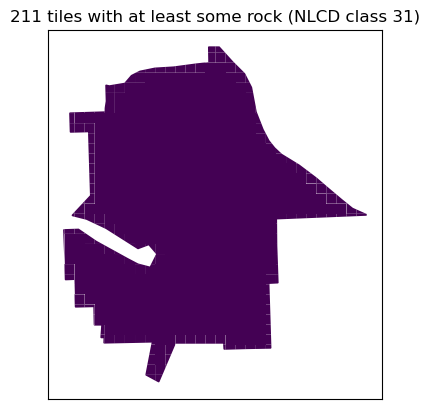

In [443]:
fig,ax=plt.subplots()
# gdf.plot(column="contains_nlcd2016_class31", ax=ax)
gdf.plot(column="percent_area_nlcd2016_class31", ax=ax)
ax.set_xticks([])
ax.set_yticks([])
plt.title(f"{num_tiles_with_rock} tiles with at least some rock (NLCD class 31)")

In [425]:
tiles_with_rock_at_centroid.sum()

/tmp/ipykernel_4301/2228803921.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  tiles_with_rock_at_centroid.sum()


Tile                          10UEU769010UEU779010UEU769110UEU759210UEU76921...
nlcd2016                                                                   1984
nlcd2016_contains_class_31                                                   64
contains_nlcd2016_class_31                                                   64
contains_nlcd2016_class31                                                    64
dtype: object

Text(0.5, 1.0, 'Baker NLCD 2016 class 31 in center of tile: (64 tiles)')

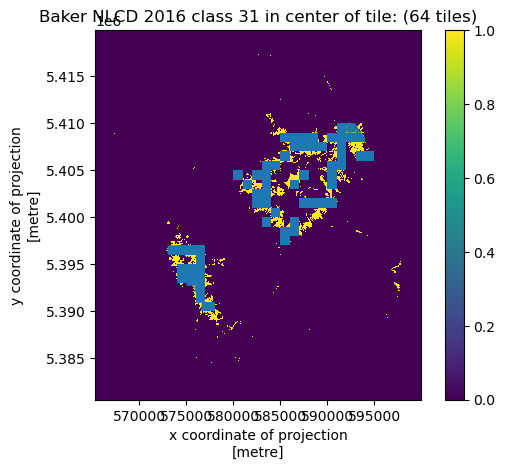

In [429]:
fig, ax= plt.subplots(1,1)#,figsize=(20,20))
baker_nlcd_rock_mask.plot(ax=ax)
tiles_with_rock_at_centroid = gdf["nlcd2016"]==31
gdf[tiles_with_rock_at_centroid].plot(ax=ax)
plt.title(f"Baker NLCD 2016 class 31 in center of tile: ({int(tiles_with_rock_at_centroid.sum())} tiles)")

<AxesSubplot:>

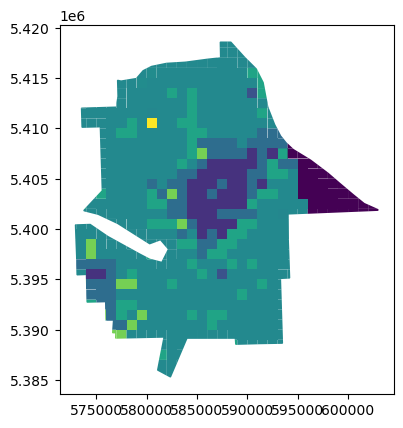

In [348]:
gdf.plot(column=gdf["nlcd2016"])

In [337]:
for p in list(gdf.centroid):
    print(p)
    print(baker_nlcd_rock_mask.sel(x=p.x, y=p.y, method="nearest").values)

POINT (581652.3696631809 5385807.909986426)
[False]
POINT (582304.0433663991 5385687.937304786)
[False]
POINT (581559.2558078449 5386481.579411102)
[False]
POINT (582460.6993724332 5386527.511101918)
[False]
POINT (583050.9622999999 5386880.465100001)
[False]
POINT (581655.8955940972 5387476.306865663)
[False]
POINT (582500 5387500)
[False]
POINT (583203.7175507937 5387597.0567079745)
[False]
POINT (581752.1611825002 5388466.894344843)
[False]
POINT (582500 5388500)
[False]
POINT (583405.7276932515 5388544.815848507)
[False]
POINT (584001.8545666666 5388995.650033333)
[False]
POINT (588884.7636455853 5388756.864410319)
[False]
POINT (589495.3103325969 5388754.748216265)
[False]
POINT (590495.0306790468 5388768.542507564)
[False]
POINT (591496.5239744337 5388780.563442794)
[False]
POINT (592496.4805334155 5388789.501216166)
[False]
POINT (593268.507372907 5388797.40866683)
[False]
POINT (576831.1684201715 5389677.800787286)
[False]
POINT (577498.0008744589 5389557.8959235735)
[False]
PO

In [ ]:
baker_nlcd_rock_mask

<AxesSubplot:>

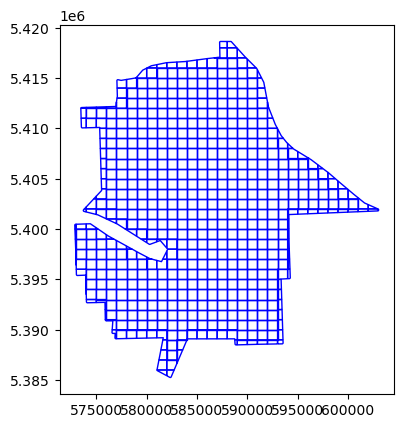

In [313]:
gdf.plot(facecolor="none", edgecolor="blue")

In [ ]:
gdf[gdf.within(west_half_bbox)].plot(ax=ax, facecolor="none", edgecolor="blue")

In [ ]:
baker_nlcd_rock_mask.sum() #63744 pixels

In [205]:
torch.tensor(np.logical_and(dem_holes, ortho_left, ortho_right).mask)

tensor([[ True, False, False,  ..., False, False, False],
        [ True,  True, False,  ..., False, False, False],
        [ True,  True, False,  ..., False, False, False],
        ...,
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False]])

In [ ]:
def get_masks(bounds, *raster_paths):
    """Build mask
    
    Bounds in the form: [minx, miny, maxx, maxy]
    Raster paths should be the filepaths for each raster
    """
    masks = []
    for path in raster_paths:
        with rasterio.open(path) as ds:
            mask = ds.read_masks(1, window=rasterio.windows.from_bounds(*bounds, ds.transform))
            masks.append(mask)
        
    return masks

# Goal of mask: inform the network of pixels that are missing data in at least one raster.
union_mask = np.logical_and(*get_masks([minx, miny, maxx, maxy], dem_with_holes_path, ortho_left_path))

plt.imshow(x)

In [171]:

# mask_union = np.logical_or(~mask_dem, ~mask_left, ~mask_right) # mask1 | mask2 | mask3 did not do union as expected, nor did np.logical_or
mask_union = np.logical_and(mask_dem, mask_left, mask_right)

In [ ]:
ncols = 4
fig, ax = plt.subplots(1,ncols, figsize=(3*ncols,3))
ax[0].imshow(mask_dem)
ax[1].imshow(mask_left)
ax[2].imshow(mask_right)
ax[3].imshow(mask_union)

plt.suptitle(tile_id)
ax[0].set_title("DEM mask")
ax[1].set_title("Ortho left")
ax[2].set_title("Ortho right")
ax[3].set_title("Union mask (inverted, 1 = hole)")
plt.tight_layout()

## Findings - Need to check if the Smoothed OUTPUT for resdepth with no mask provided is better than the INTERPOLATED INPUT i already provided (rasterio.fill.fillnodata). Hard to say how the network would improve say 10UEU8497 if the orthos also have a lot of holes. Basically need to understand the characteristics of the datasets better...

# Create DEM mosaics

In [98]:
!pwd

/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/torchgeo_experiments


In [10]:
import torch
import os
# Just to import ResDepth model for quick test
import sys
sys.path.insert(0, "/mnt/1.0_TB_VOLUME/sethv/resdepth_all/ResDepth/")
from lib.UNet import UNet
from torchgeo.samplers import RandomBatchGeoSampler # appropriate for tile based dataset
from torchgeo_dataset import TGDSMOrthoDataset
from torchvision.transforms import Compose
from typing import Any, Callable, Dict, List, Optional
from torchgeo.datasets import stack_samples

import torchvision
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar

def hillshade(array, azimuth=315, angle_altitude=45):
    """Borrow hillshade 
    
    https://github.com/uw-cryo/wv_stereo_processing/blob/54f3e82f313773e57dea8c3af5f05bb69e6b0a68/notebooks/gm_aso_dg_comparison.ipynb"""

    # Source: http://geoexamples.blogspot.com.br/2014/03/shaded-relief-images-using-gdal-python.html

    x, y = np.gradient(array)
    slope = np.pi/2. - np.arctan(np.sqrt(x*x + y*y))
    aspect = np.arctan2(-x, y)
    azimuthrad = azimuth*np.pi / 180.
    altituderad = angle_altitude*np.pi / 180.


    shaded = np.sin(altituderad) * np.sin(slope) \
     + np.cos(altituderad) * np.cos(slope) \
     * np.cos(azimuthrad - aspect)
    return 255*(shaded + 1)/2

from torch.utils.data import DataLoader
def remove_bbox(sample: Dict[str, Any]) -> Dict[str, Any]:
    """Removes the bounding box property from a sample.

    Args:
        sample: dictionary with geographic metadata

    Returns
        sample without the bbox property
    """
    del sample["bbox"]
    return sample

In [11]:

val_directory = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/"#west_half_baker_mapproject_w_asp_refdem"
print("Loading validation dataset")
train_transforms = Compose([remove_bbox])
dataset = TGDSMOrthoDataset(root=val_directory, split="train", transforms=train_transforms)
BATCH_SIZE = 20
TILE_SIZE=256
RESOLUTION = 1.0
sampler = RandomBatchGeoSampler(dataset, batch_size=BATCH_SIZE, size=TILE_SIZE, length=5000)
dataloader = DataLoader(dataset, batch_sampler=sampler, collate_fn=stack_samples, num_workers=20)


Loading validation dataset
Initial DEM pattern: /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022/**/files_to_zip/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM_holes_filled.tif
Adding files to list & spatial index...
Have 0 tiles


ValueError: Bounding box is invalid: 'minx=1.7976931348623157e+308' > 'maxx=-1.7976931348623157e+308'

In [12]:
def call_model(model, model_input_tensor : torch.Tensor):
    """Helper: given pytorch model & input rasters, return model output as numpy array"""
    # model_input = np.stack(inputs)
    # # print(model_input.shape)
    # model_input_tensor = torch.tensor(model_input).unsqueeze(0)
    tile_output = model(model_input_tensor).detach().numpy().squeeze()
    return tile_output

ckpt = "/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/torchgeo_experiments/tb_logs/resdepth_torchgeo/version_14/checkpoints/epoch=870-step=217750.ckpt"
resdepth_state_dict = torch.load(ckpt)
# resdepth_state_dict = torch.load(run_folder + "/checkpoints/Model_best.pth") # 2021 trained model
print("Loaded best model from epoch", resdepth_state_dict['epoch'])
model_args = {'n_input_channels': 3, 'start_kernel': 64, 'depth': 5, 'act_fn_encoder': 'relu', 'act_fn_decoder': 'relu', 'act_fn_bottleneck': 'relu', 'up_mode': 'transpose', 'do_BN': True, 'outer_skip': True, 'outer_skip_BN': False, 'bias_conv_layer': True}
checkpoint_model = UNet(**model_args)
# # print(resdepth_state_dict.keys())
# # print(type(resdepth_state_dict["state_dict"]))
# print(resdepth_state_dict["state_dict"].keys())

# TODO if statement
checkpoint_model.load_state_dict({k[5:]:v for k,v in resdepth_state_dict["state_dict"].items()}) # cut off the 'unet.' in state dict???

Loaded best model from epoch 870


<All keys matched successfully>

In [222]:

# TODO copied from previous experiment, curious
dsm_mean_std = {'mean': None, 'std': 33.336839170631755}
dsm_std = dsm_mean_std["std"]
ortho_mean_std = {'mean': 261.1999816894531, 'std': 245.63670349121094}
ortho_mean = ortho_mean_std["mean"]
ortho_std = ortho_mean_std["std"]


In [211]:
b=0
for batch in dataloader:
    
    print("On batch", b)
    b+= 1
    # if b < 100:
    #     continue
    # if b > 100:
    #     print("Done")
    #     break
    if b > 1:
        break
    dsm_mean = batch["inputs"][:,0].nanmean().numpy()
    if dsm_mean < 2500:
        continue

    # tile_dsm_normalized = torchvision.transforms.Normalize(dsm_mean, dsm_std)(torch.tensor([tile_dsm.data])).numpy().squeeze()
    print("Input DSM mean before normalization", dsm_mean)
    normalized_inputs = torch.tensor(batch["inputs"])
    normalized_inputs[:,0] =torchvision.transforms.Normalize(dsm_mean, dsm_std)(normalized_inputs[:,0])
    print("Input DSM mean after normalization", normalized_inputs[:,0].mean().numpy())

    normalized_inputs[:,1:] = torchvision.transforms.Normalize(ortho_mean, ortho_std)(normalized_inputs[:,1:])

    output = call_model(checkpoint_model, normalized_inputs)
    # print(output.shape)

    # # Un-normalize the output
    # print("output.shape", output.shape)
    # print("dsm_std", type(dsm_std), dsm_std)
    # print("dsm_mean", type(dsm_mean), dsm_mean)

    # print("Plotting batch")
    print("dsm_mean:", dsm_mean)
    print("dsm_std:", dsm_std)
    print("output mean of batch:", output.mean())
    output = (output * dsm_std) + dsm_mean
    print("output shape", output.shape)
    output = output.reshape(BATCH_SIZE, TILE_SIZE, TILE_SIZE)
    print("output shape", output.shape)
    # assert 0
    print("output mean of batch:", output.mean())
    print("output range of batch:", output.min(), output.max())

    # Plot example
    image = batch["inputs"]
    target = batch["target"]

    # print(image.shape)
    # print(target.shape)
    ncols = 8
    nrows = 20# BATCH_SIZE
    fig, ax = plt.subplots(nrows, ncols, figsize=(2*ncols,2+2*nrows))
    plt.suptitle(f"Validation tiles: Batch of size {image.shape[0]} \nCheckpoint: {ckpt}\nDataset: {val_directory}, Tiles=???")
    # print(batch["bbox"])
    # bboxes.extend(batch["bbox"])
    # shapely.geometry.Box()

    # assert 0
    # TODO do rest of loop
    plt.rcParams["figure.dpi"] = 300
    ax = ax.reshape(nrows,ncols)
    
    

    for i in range(nrows):
        for j in range(ncols):
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])
            
            
        output_dem = output[i]
        # # Normalize the naive way
        # output_dem = (output_dem * dsm_std) + dsm_mean
        ELEV_VMIN = min(initial_dem.min(), output_dem.min(), gt_dem.min())
        ELEV_VMAX = max(initial_dem.max(), output_dem.max(), gt_dem.max())
        
        initial_dem = image[i][0].numpy().squeeze()
        ax[i][0].imshow(hillshade(initial_dem), cmap="gray", rasterized=True, aspect="equal")
        im = ax[i][0].imshow(initial_dem, alpha=0.5, rasterized=True, aspect="equal", vmin=ELEV_VMIN, vmax=ELEV_VMAX)
        ax[i][0].set_title("initial DEM")
        plt.colorbar(im, ax=ax[i][0], fraction=0.04)
        

        im = ax[i][1].imshow(image[i][1].numpy().squeeze(), cmap="gray", rasterized=True, aspect="equal")
        ax[i][1].set_title("ortho left")
        plt.colorbar(im, ax=ax[i][1], fraction=0.04)
        
        scale = RESOLUTION
        ax[i][1].add_artist(ScaleBar(scale, fixed_value=50))


        im = ax[i][2].imshow(image[i][2].numpy().squeeze(), cmap="gray", rasterized=True, aspect="equal")
        ax[i][2].set_title("ortho right")
        plt.colorbar(im, ax=ax[i][2], fraction=0.04)

        gt_dem = target[i].numpy().squeeze()
        ax[i][3].imshow(hillshade(gt_dem), cmap="gray", rasterized=True, aspect="equal")
        im = ax[i][3].imshow(gt_dem, alpha=0.5, rasterized=True, aspect="equal", vmin=ELEV_VMIN, vmax=ELEV_VMAX)
        ax[i][3].set_title("lidar DEM")
        plt.colorbar(im, ax=ax[i][3], fraction=0.04)

        

        ax[i][4].imshow(hillshade(output_dem), cmap="gray", rasterized=True, aspect="equal")
        im = ax[i][4].imshow(output_dem, alpha=0.5, rasterized=True, aspect="equal", vmin=ELEV_VMIN, vmax=ELEV_VMAX)
        ax[i][4].set_title("refined DEM")
        plt.colorbar(im, ax=ax[i][4], fraction=0.04)
        
        VMIN, VMAX = -10, 10

        residual = output_dem - initial_dem
        im = ax[i][5].imshow(residual, cmap="RdBu", rasterized=True, aspect="equal", vmin=VMIN, vmax=VMAX)
        ax[i][5].set_title(f"residual DEM refinement\nRange: [{residual.min():.1f}, {residual.max():.1f}]")
        plt.colorbar(im, ax=ax[i][5], fraction=0.04)

        initial_error_vs_gt = initial_dem - gt_dem
        im = ax[i][6].imshow(initial_error_vs_gt, cmap="RdBu", rasterized=True, aspect="equal", vmin=VMIN, vmax=VMAX)
        ax[i][6].set_title(f"Initial - Lidar\nMAE: {np.mean(np.abs(initial_error_vs_gt)):.1f}")#[{initial_error_vs_gt.min():.1f}, {initial_error_vs_gt.max():.1f}]")
        plt.colorbar(im, ax=ax[i][6], fraction=0.04)

        output_error_vs_gt = output_dem - gt_dem
        im = ax[i][7].imshow(output_error_vs_gt, cmap="RdBu", rasterized=True, aspect="equal", vmin=VMIN, vmax=VMAX)
        ax[i][7].set_title(f"Output - Lidar\nMAE: {np.mean(np.abs(output_error_vs_gt)):.1f}")#[{output_error_vs_gt.min():.1f}, {output_error_vs_gt.max():.1f}]")
        plt.colorbar(im, ax=ax[i][7], fraction=0.04)



    plt.tight_layout()
    plt.savefig(f"junk_val_rd_out_batch.png")
    
    break
    # plt.show()


Input DSM mean before normalization 2595.3604
Input DSM mean after normalization -6.878376e-06


/tmp/ipykernel_11176/450449552.py:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  normalized_inputs = torch.tensor(batch["inputs"])


dsm_mean: 2595.3604
dsm_std: 33.336839170631755
output mean of batch: 0.0014123715
output shape (20, 256, 256)
output shape (20, 256, 256)
output mean of batch: 2595.4077
output range of batch: 2302.1528 2839.9001


## Plotting debugging code

In [68]:
image = np.random.randint(-100,50,(256,256))

In [ ]:
import matplotlib.colors
# Having different colorscale for positive and negative values is too confusing, just set vmin&vmax?
centered_at_zero = matplotlib.colors.TwoSlopeNorm(vcenter=0)#vmin=-500., vcenter=0, vmax=4000)
plt.imshow(image, cmap="RdBu", norm=centered_at_zero)
plt.colorbar()

In [7]:
biggest_bbox = shapely.geometry.box(583000, 5411000, 591000, 5395000)
# ulx, uly, lrx, lry, area_name = (582160,5411392, 591528,5394757, "baker_largest_bbox")

west_half_bbox = shapely.geometry.box(583000, 5411000, 587000, 5395000)
east_half_bbox = shapely.geometry.box(587000, 5411000, 591000, 5395000)

In [21]:
pattern = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/*10UEU8896*/**/*intensity*stdev.tif"
list(glob.glob(pattern))

['/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8896_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8896_LAS_2017_32610_first_filt_v1.3_1.0m_intensity_all_stdev.tif']

In [23]:
import glob


['10UEU8399',
 '10UEV9006',
 '10UEV8304',
 '10UEV8903',
 '10UEU8998',
 '10UEV8801',
 '10UEV8807',
 '10UEV8501',
 '10UEU8495',
 '10UEV8707',
 '10UEU8496',
 '10UEV9010',
 '10UEU8599',
 '10UEV8601',
 '10UEU8695',
 '10UEV8510']

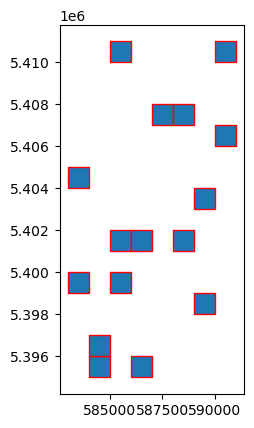

In [15]:
# validation_tiles = list(gdf_bbox["Tile"].sample(16))
gdf_bbox[gdf_bbox["Tile"].isin(validation_tiles)].plot(edgecolor="red")
validation_tiles

In [13]:
validation_tiles = [
    '10UEU8399',
    '10UEV9006',
    '10UEV8304',
    '10UEV8903',
    '10UEU8998',
    '10UEV8801',
    '10UEV8807',
    '10UEV8501',
    '10UEU8495',
    '10UEV8707',
    '10UEU8496',
    '10UEV9010',
    '10UEU8599',
    '10UEV8601',
    '10UEU8695',
    '10UEV8510'
]

In [14]:
gdf_bbox[~completed]
# Check if ASP stuff got run for 8*08,09,10

NameError: name 'completed' is not defined

In [91]:
!find /mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/ -name "*intensity*stdev.tif"

/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8699_LAS_2017_32610_first_filt_v1.3_1.0m_intensity_all_stdev.tif
/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8803_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEV8803_LAS_2017_32610_first_filt_v1.3_1.0m_intensity_all_stdev.tif
/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEV8909_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEV8909_LAS_2017_32610_first_filt_v1.3_1.0m_intensity_all_stdev.tif
/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8998_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8998_LAS_2017_32610_first_filt_v1.3_1.0m_intensity_all_stdev.

In [244]:
completed.sum()

128

In [245]:
import numpy as np

In [251]:
len(np.zeros((1,2,3)).shape)

3

## 11/21/22 Training data statistics

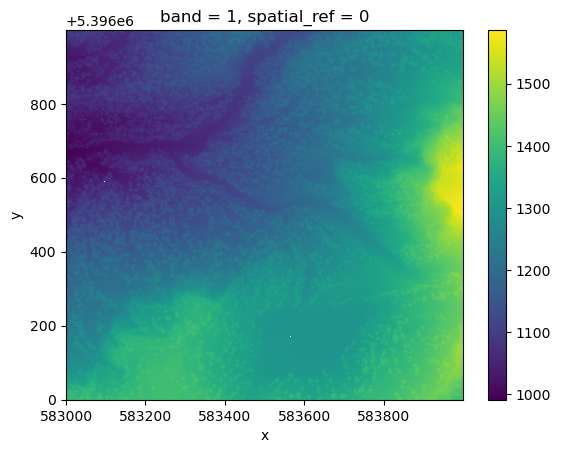

In [105]:
example_gt_weightedavg_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017_32610_first_filt_v1.3_1.0m-DEM.tif"
rioxarray.open_rasterio(example_gt_weightedavg_fn, masked=True).plot(rasterized=True)

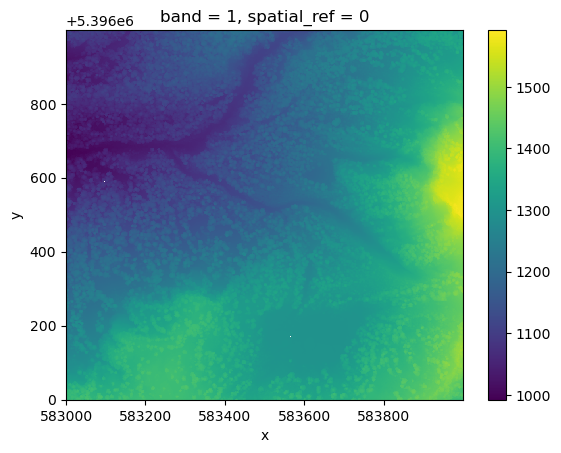

In [106]:
example_gt_max_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017_32610_first_filt_v1.3_1.0m-max-DEM.tif"
rioxarray.open_rasterio(example_gt_max_fn, masked=True).plot(rasterized=True)

In [199]:
validation_tiles

['10UEU8399',
 '10UEV9006',
 '10UEV8304',
 '10UEV8903',
 '10UEU8998',
 '10UEV8801',
 '10UEV8807',
 '10UEV8501',
 '10UEU8495',
 '10UEV8707',
 '10UEU8496',
 '10UEV9010',
 '10UEU8599',
 '10UEV8601',
 '10UEU8695',
 '10UEV8510']

In [16]:
train_tiles = gdf_bbox[~gdf_bbox["Tile"].isin(validation_tiles)]["Tile"]
len(train_tiles)

112

In [257]:
new_train_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/TRAIN_tile_stack_baker_128_global_coreg/"
os.makedirs(new_train_dir, exist_ok=True)
for tile_id in train_tiles:
    tile_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017/"
    !cp -r $tile_dir $new_train_dir
print(f"Copied {len(train_tiles)} training tiles")

Copied 10UEV8910 training tiles


In [254]:
new_validation_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/VALIDATION_tile_stack_baker_128_global_coreg/"
os.makedirs(new_validation_dir, exist_ok=True)
for tile_id in validation_tiles:
    tile_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017/"
    !cp -n -r $tile_dir $new_validation_dir
    print(f"Copied {tile_id}")

Copied 10UEU8399
Copied 10UEV9006
Copied 10UEV8304
Copied 10UEV8903
Copied 10UEU8998
Copied 10UEV8801
Copied 10UEV8807
Copied 10UEV8501
Copied 10UEU8495
Copied 10UEV8707
Copied 10UEU8496
Copied 10UEV9010
Copied 10UEU8599
Copied 10UEV8601
Copied 10UEU8695
Copied 10UEV8510


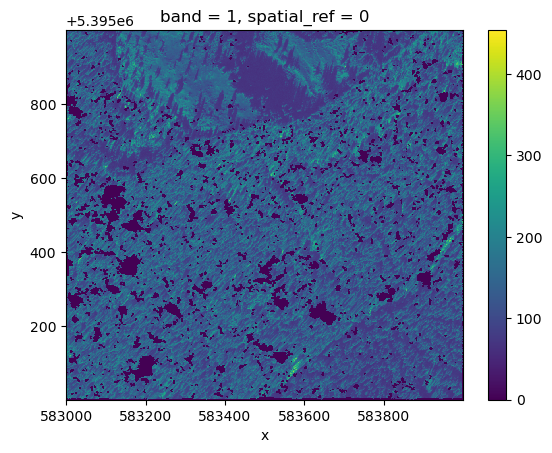

In [260]:
rioxarray.open_rasterio("/mnt/1.0_TB_VOLUME/sethv/shashank_data/TRAIN_tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8395_LAS_2017/lower_easton3/files_to_zip/1020010043455300.r100_ortho_1.0m_ba.tif").plot()

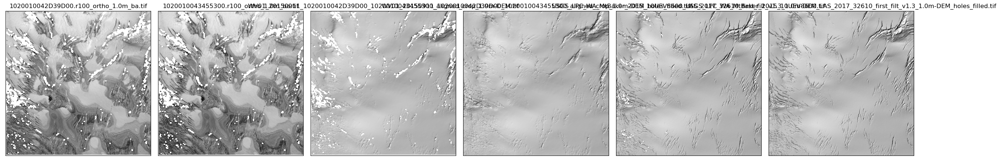

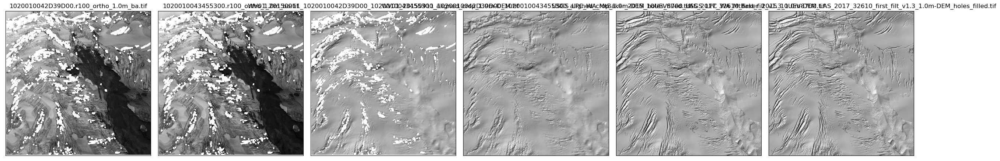

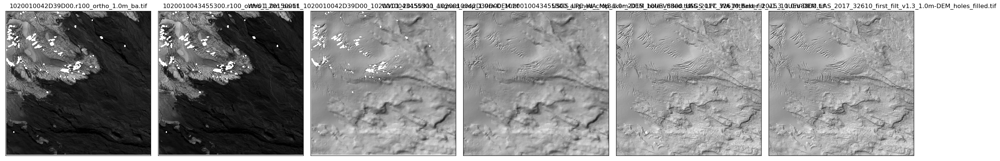

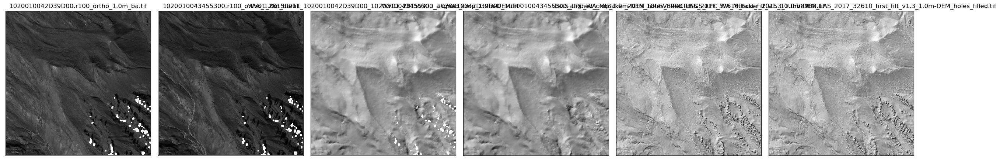

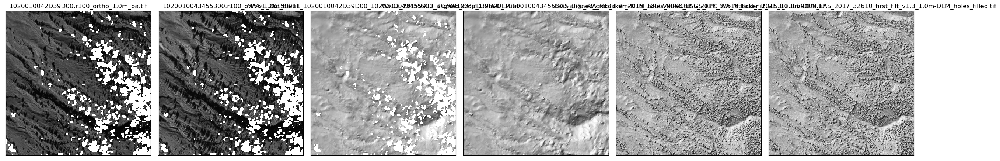

In [22]:
# tile_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8795_LAS_2017/lower_easton3"
# tile_id = "10UEV9010"
for tile_id in train_tiles[37:42]:#:5]:
    tile_dir = f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/TRAIN_tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017/lower_easton3"
    # !ls $tile_dir/files_to_zip
    ortho_left = "1020010042D39D00.r100_ortho_1.0m_ba.tif"
    ortho_right = "1020010043455300.r100_ortho_1.0m_ba.tif"
    # usgs_dem_filled = "USGS_LPC_WA_MtBaker_2015_10UEU8795_LAS_2017_32610_first_filt_v1.3_1.0m-DEM_holes_filled.tif"
    wv_dem_filled = "WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM_holes_filled.tif"
    usgs_dem_filled = f"USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017_32610_first_filt_v1.3_1.0m-DEM_holes_filled.tif"
    wv_dem = "WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM.tif"
    usgs_dem = f"USGS_LPC_WA_MtBaker_2015_{tile_id}_LAS_2017_32610_first_filt_v1.3_1.0m-DEM.tif"

    # show = [ortho_left, ortho_right, usgs_dem_filled, wv_dem_filled]
    show = [ortho_left, ortho_right, wv_dem, wv_dem_filled, usgs_dem, usgs_dem_filled]#, wv_dem_filled, usgs_dem, wv_dem]
    fig, ax = plt.subplots(ncols=len(show), figsize=(25,5))

    for i, fn in enumerate(show):
        full_path = os.path.join(tile_dir, "files_to_zip", fn)
        raster=  rioxarray.open_rasterio(full_path, masked=True)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        if "DEM" in fn:
            ax[i].imshow(hillshade(raster.squeeze()), cmap="gray", rasterized=True, aspect="equal")
        else:
            ax[i].imshow(raster.squeeze(), rasterized=True, cmap="gray", aspect="equal")
        ax[i].set_title(fn)
        ax[i].set_aspect(1)
    plt.tight_layout()

In [107]:
root_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/"
# pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned-trans_source-log-point2las-11-21-0542-18630.txt"
example_dem_max_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-max-DEM.tif"
example_dem_weightedavg_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM.tif"



In [123]:
"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017"[-18:-9]

'10UEU8396'

In [120]:
len("10UEU8396_LAS_2017")

18

In [169]:
import xarray
from xarray.backends import file_manager
del file_manager.FILE_CACHE
from xarray.core.options import OPTIONS
from xarray.backends.lru_cache import LRUCache
file_manager.FILE_CACHE = LRUCache(
    maxsize=OPTIONS["file_cache_maxsize"], on_evict=lambda k, v: v.close()
)

In [195]:
root_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/"
stds = []
for tile in sorted(glob.glob(root_dir + "*")):
    tile_id = os.path.basename(tile)[-18:-9] # TODO just go by tile id in first place
    dem_weightedavg_fn = list(glob.glob(os.path.join(tile, "lower_easton3/USGS*1.0m-DEM.tif")))[0]
    # dem_max_fn = "lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-max-DEM.tif"
    usgs_dem = rioxarray.open_rasterio(dem_weightedavg_fn, masked=True)#.plot(rasterized=True)
    std = usgs_dem.std()
    stds.append(std)
    # print(f"Stats for {tile_id} USGS max dem: min={usgs_dem.min():.1f}, max={usgs_dem.max():.1f}, median={usgs_dem.median():.1f}, mean={usgs_dem.mean():.1f}, std={usgs_dem.std():.1f}")
    
import numpy as np
print(len(stds))
print(np.mean(stds))

128
110.60689


In [211]:
# compute stats
root_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/"
stds = []
means = []
for tile in sorted(glob.glob(root_dir + "*")):
    tile_id = os.path.basename(tile)[-18:-9] # TODO just go by tile id in first place
    left_ortho_fns = list(glob.glob(os.path.join(tile, "lower_easton3/1020010042D39D00*ortho*.tif")))
    assert len(left_ortho_fns) == 1, "should have 1 left ortho for each"
    for of in left_ortho_fns:
        ortho = rioxarray.open_rasterio(of, masked=True)#.plot(rasterized=True)
        means.append(ortho.mean())
        stds.append(ortho.std())
import numpy as np
print(len(stds))
print(f"Left ortho mean: {np.mean(means):.1f}, std={np.mean(stds):.1f}")

128
Left ortho mean: 418.4, std=181.1


In [212]:
# compute stats
root_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/"
stds = []
means = []
for tile in sorted(glob.glob(root_dir + "*")):
    tile_id = os.path.basename(tile)[-18:-9] # TODO just go by tile id in first place
    right_ortho_fns = list(glob.glob(os.path.join(tile, "lower_easton3/1020010043455300*ortho*.tif")))
    assert len(right_ortho_fns) == 1, "should have 1 left ortho for each"
    for of in right_ortho_fns:
        ortho = rioxarray.open_rasterio(of, masked=True)#.plot(rasterized=True)
        means.append(ortho.mean())
        stds.append(ortho.std())
import numpy as np
print(len(stds))
print(f"Right ortho mean: {np.mean(means):.1f}, std={np.mean(stds):.1f}")

128
Right ortho mean: 364.6, std=171.8


In [168]:
for tile in sorted(glob.glob(root_dir + "*")):
    tile_id = os.path.basename(tile)[-18:-9] # TODO just go by tile id in first place
    dem_weightedavg_fn = "lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM.tif"
    dem_max_fn = "lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-max-DEM.tif"
    asp_dem = rioxarray.open_rasterio(tile + '/' + dem_max_fn, masked=True)#.plot(rasterized=True)
    if asp_dem.mean() < 3500:
        continue
    print(f"Stats for {tile_id} ASP max dem: min={asp_dem.min():.1f}, max={asp_dem.max():.1f}, median={asp_dem.median():.1f}, mean={asp_dem.mean():.1f}")
    plt.figure()
    asp_dem.plot(cmap="inferno")

Stats for 10UEU8395 ASP max dem: min=1033.0, max=1535.0, median=1296.9, mean=1291.8
Stats for 10UEU8396 ASP max dem: min=1092.8, max=71845.9, median=68055.7, mean=56148.3
Stats for 10UEU8397 ASP max dem: min=50062.4, max=314529.9, median=160313.3, mean=187410.2
Stats for 10UEU8398 ASP max dem: min=-666.6, max=3743.6, median=1513.7, mean=1507.5
Stats for 10UEU8399 ASP max dem: min=-640.0, max=3614.7, median=1338.0, mean=1343.1
Stats for 10UEU8495 ASP max dem: min=63455.9, max=209165.2, median=158377.6, mean=158921.5
Stats for 10UEU8496 ASP max dem: min=1306.6, max=1648.6, median=1499.4, mean=1491.3
Stats for 10UEU8497 ASP max dem: min=-212.8, max=3118.0, median=1424.7, mean=1481.4
Stats for 10UEU8498 ASP max dem: min=296.6, max=2980.4, median=1593.4, mean=1600.5
Stats for 10UEU8499 ASP max dem: min=-556.3, max=4270.5, median=1701.4, mean=1657.5


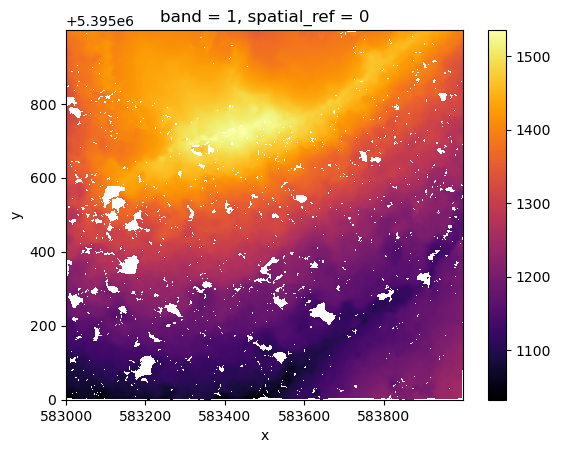

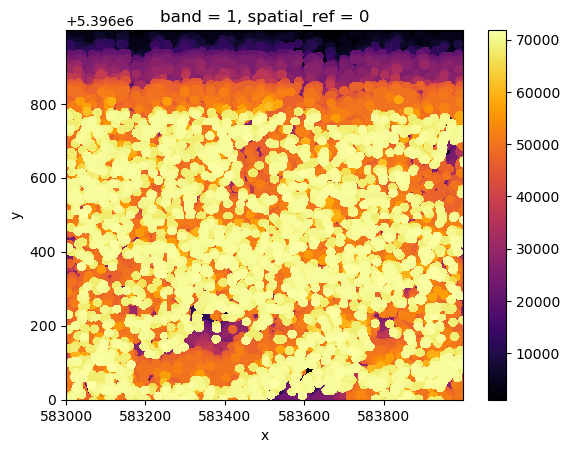

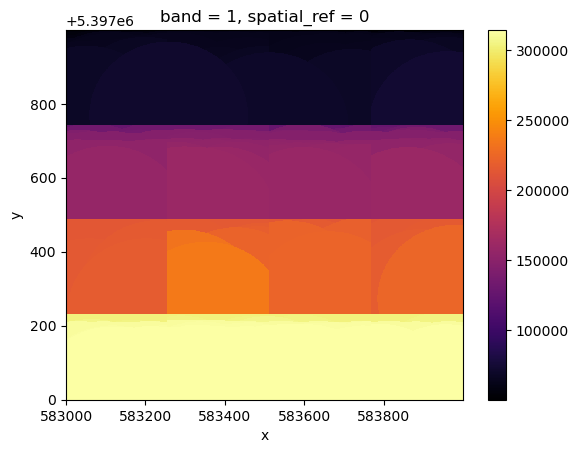

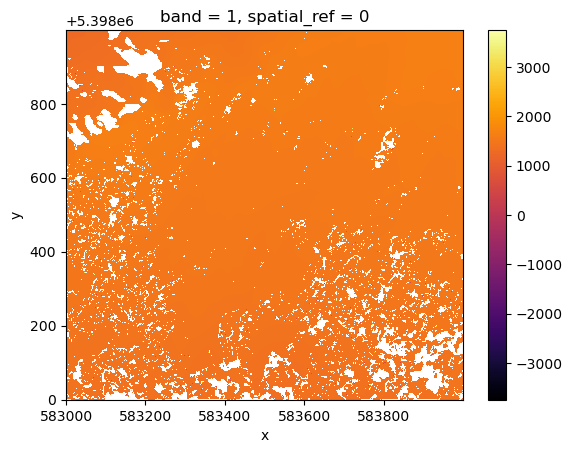

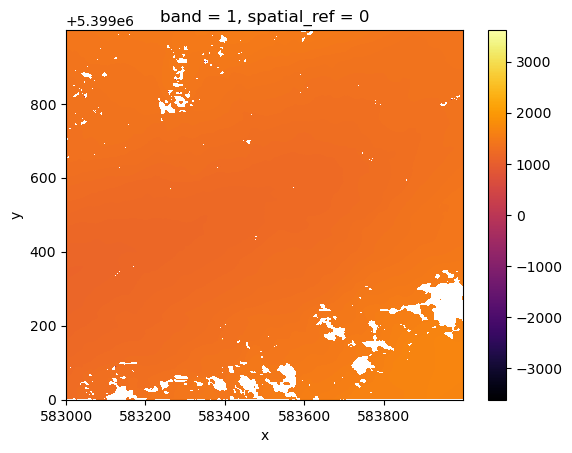

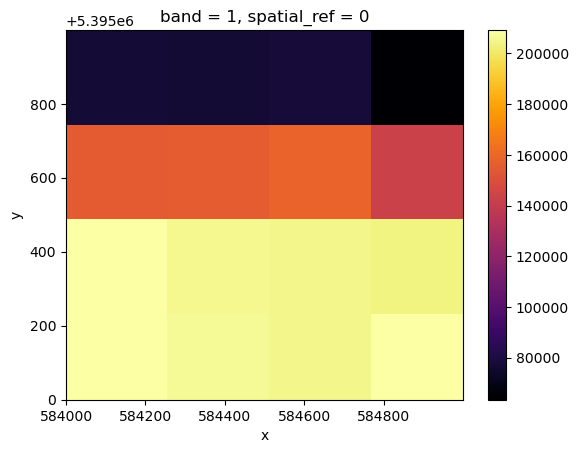

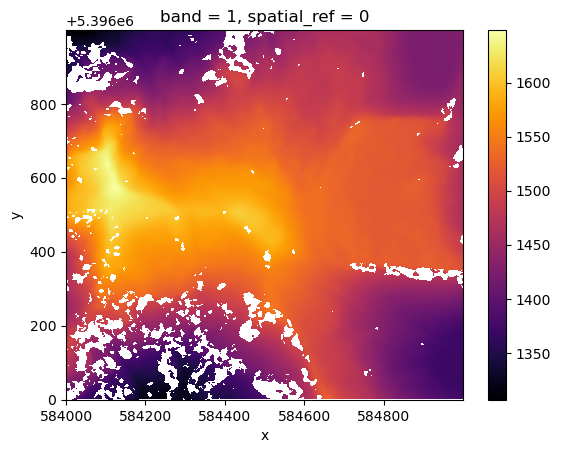

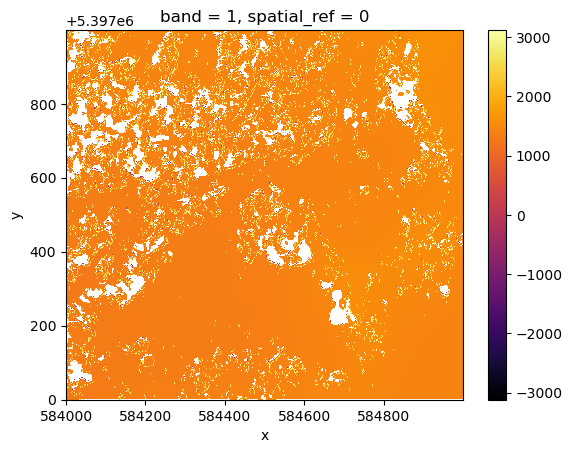

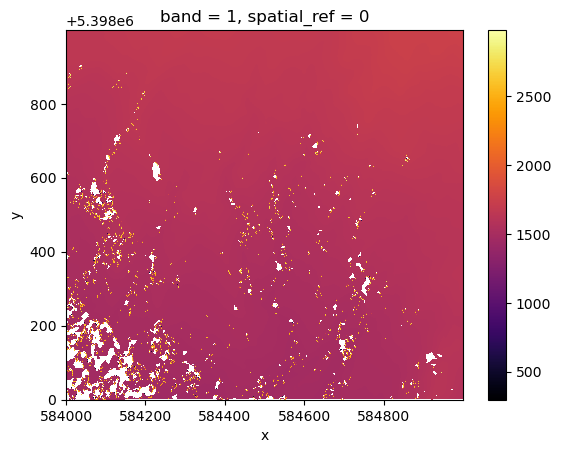

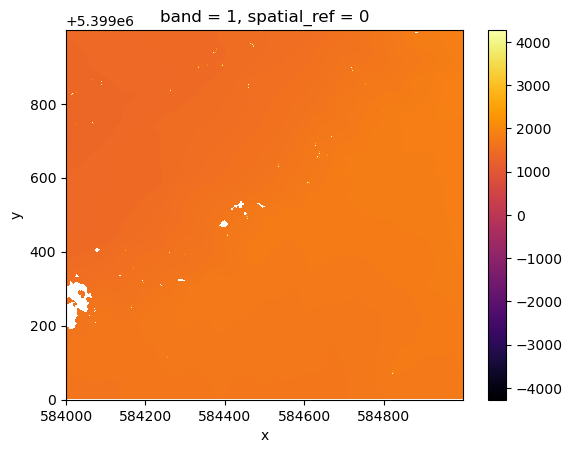

In [145]:
for tile in sorted(glob.glob(root_dir + "*"))[:10]:
    tile_id = os.path.basename(tile)[-18:-9] # TODO just go by tile id in first place
    dem_weightedavg_fn = "lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM.tif"
    dem_max_fn = "lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-max-DEM.tif"
    asp_dem = rioxarray.open_rasterio(tile + '/' + dem_max_fn, masked=True)#.plot(rasterized=True)
    print(f"Stats for {tile_id} ASP max dem: min={asp_dem.min():.1f}, max={asp_dem.max():.1f}, median={asp_dem.median():.1f}, mean={asp_dem.mean():.1f}")

    plt.figure()
    asp_dem.plot(cmap="inferno")

In [150]:
root_dir = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/"
# pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned-trans_source-log-point2las-11-21-0542-18630.txt"
example_dem_max_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-max-DEM.tif"
example_dem_weightedavg_fn = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/pc_laz_prep_full_outputs_USGS_LPC_WA_MtBaker_2015_10UEU8396_LAS_2017/lower_easton3/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM.tif"



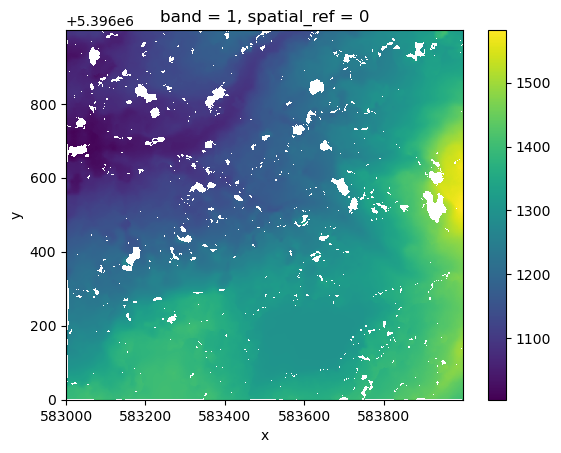

In [151]:
rioxarray.open_rasterio(example_dem_weightedavg_fn, masked=True).plot(rasterized=True)

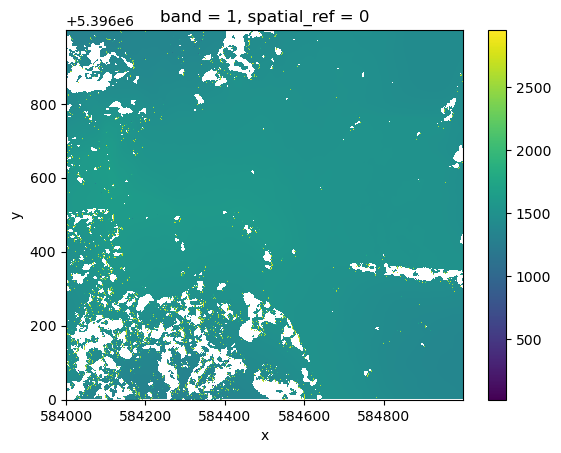

In [115]:
rioxarray.open_rasterio(example_dem_max_fn, masked=True).plot(rasterized=True)

In [96]:
!ls $root_dir | wc

    128     128    8832


In [82]:
import geopandas as gpd
usgs_dir = os.path.join(project_root, "resdepth_all/deep-elevation-refinement/notebooks/dataset_search/")

gdf = gpd.read_file(os.path.join(usgs_dir, "Mt_Baker_LiDAR_Tile_Index.shp"))

In [85]:
!pwd

/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/torchgeo_experiments


In [89]:
m = gdf.explore()
m.save(os.path.join(tile_metadata_dir, "gpd_explore_Mt_Baker_LiDAR_Tile_Index.html"))

NameError: name 'rioxarray' is not defined

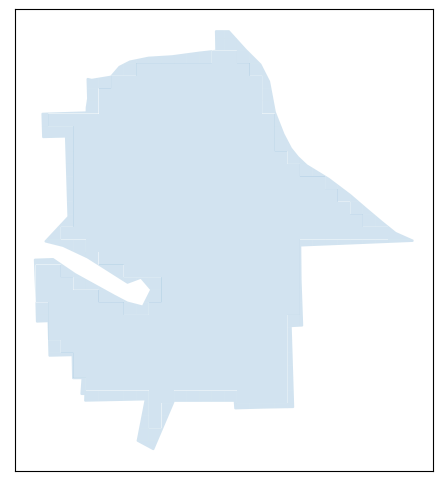

In [81]:
import shapely
import pathlib
import os
import glob
import geopandas as gpd
import matplotlib.pyplot as plt
project_root = pathlib.Path("/mnt/1.0_TB_VOLUME/sethv")
usgs_dir = os.path.join(project_root, "resdepth_all/deep-elevation-refinement/notebooks/dataset_search/")
biggest_bbox = shapely.geometry.box(583000, 5411000, 591000, 5395000)

gdf = gpd.read_file(os.path.join(usgs_dir, "Mt_Baker_LiDAR_Tile_Index.shp"))
fig, ax = plt.subplots(figsize=(6,6))
gdf.plot(ax=ax, alpha=0.2)
gdf_bbox = gdf[gdf.within(biggest_bbox)]
ax.set_xticks([])
ax.set_yticks([])
example_dtm30_fn = "/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/torchgeo_experiments/baker_2015_utm_m_30m.tif"
example_dtm30 = rioxarray.open_rasterio(example_dtm30_fn, masked=True)

example_dtm30_copy = example_dtm30.copy()
example_dtm30_copy.data[:0] = hillshade(example_dtm30.squeeze())
example_dtm30_copy.plot(ax=ax, cmap="gray")#, alpha=0.5)
example_dtm30.plot(ax=ax, cmap="inferno", alpha=0.5)


completed = gdf_bbox["Tile"].apply(lambda t : len(list(glob.glob(f"/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stack_baker_128_global_coreg/*{t}*/**/*intensity*stdev.tif"))) > 0)
gdf_bbox.plot(ax=ax, facecolor="none", edgecolor="yellow") #alpha=0.9)
# gdf_bbox[completed].plot(ax=ax, facecolor="none", edgecolor="blue", label="training", legend=True)
# plt.title("3DEP Tile stacks completed so far (up to stdev.tif)")
gdf_bbox[gdf_bbox["Tile"].isin(validation_tiles)].plot(ax=ax, edgecolor="red", facecolor="none", label="validation", legend=True)
plt.title("3DEP Tile Train & Val datasets")
ax.set_aspect(1)
# plt.legend()

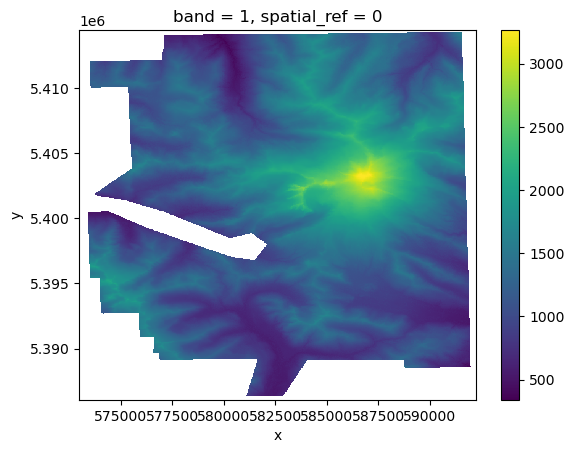

In [230]:
example_dtm30_fn = "/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/ResDepth/torchgeo_experiments/baker_2015_utm_m_30m.tif"
example_dtm30 = rioxarray.open_rasterio(example_dtm30_fn, masked=True)
example_dtm30.data[:0] = hillshade(example_dtm30.squeeze())
example_dtm30.plot()
# plt.imshow(, aspect="equal", cmap="gray")

In [58]:
list(gdf[gdf.within(west_half_bbox)]["Tile"]) # 64 tiles on west half of Baker



['10UEU8395',
 '10UEU8495',
 '10UEU8595',
 '10UEU8695',
 '10UEU8396',
 '10UEU8496',
 '10UEU8596',
 '10UEU8696',
 '10UEU8397',
 '10UEU8497',
 '10UEU8597',
 '10UEU8697',
 '10UEU8398',
 '10UEU8498',
 '10UEU8598',
 '10UEU8698',
 '10UEU8399',
 '10UEU8499',
 '10UEU8599',
 '10UEU8699',
 '10UEV8300',
 '10UEV8400',
 '10UEV8500',
 '10UEV8600',
 '10UEV8301',
 '10UEV8401',
 '10UEV8501',
 '10UEV8601',
 '10UEV8302',
 '10UEV8402',
 '10UEV8502',
 '10UEV8602',
 '10UEV8303',
 '10UEV8403',
 '10UEV8503',
 '10UEV8603',
 '10UEV8304',
 '10UEV8404',
 '10UEV8504',
 '10UEV8604',
 '10UEV8305',
 '10UEV8405',
 '10UEV8505',
 '10UEV8605',
 '10UEV8306',
 '10UEV8406',
 '10UEV8506',
 '10UEV8606',
 '10UEV8307',
 '10UEV8407',
 '10UEV8507',
 '10UEV8607',
 '10UEV8308',
 '10UEV8408',
 '10UEV8508',
 '10UEV8608',
 '10UEV8309',
 '10UEV8409',
 '10UEV8509',
 '10UEV8609',
 '10UEV8310',
 '10UEV8410',
 '10UEV8510',
 '10UEV8610']

In [54]:
list(gdf[gdf.within(east_half_bbox)]["Tile"]) # 64 tiles on east half of Baker

['10UEU8795',
 '10UEU8895',
 '10UEU8995',
 '10UEU9095',
 '10UEU8796',
 '10UEU8896',
 '10UEU8996',
 '10UEU9096',
 '10UEU8797',
 '10UEU8897',
 '10UEU8997',
 '10UEU9097',
 '10UEU8798',
 '10UEU8898',
 '10UEU8998',
 '10UEU9098',
 '10UEU8799',
 '10UEU8899',
 '10UEU8999',
 '10UEU9099',
 '10UEV8700',
 '10UEV8800',
 '10UEV8900',
 '10UEV9000',
 '10UEV8701',
 '10UEV8801',
 '10UEV8901',
 '10UEV9001',
 '10UEV8702',
 '10UEV8802',
 '10UEV8902',
 '10UEV9002',
 '10UEV8703',
 '10UEV8803',
 '10UEV8903',
 '10UEV9003',
 '10UEV8704',
 '10UEV8804',
 '10UEV8904',
 '10UEV9004',
 '10UEV8705',
 '10UEV8805',
 '10UEV8905',
 '10UEV9005',
 '10UEV8706',
 '10UEV8806',
 '10UEV8906',
 '10UEV9006',
 '10UEV8707',
 '10UEV8807',
 '10UEV8907',
 '10UEV9007',
 '10UEV8708',
 '10UEV8808',
 '10UEV8908',
 '10UEV9008',
 '10UEV8709',
 '10UEV8809',
 '10UEV8909',
 '10UEV9009',
 '10UEV8710',
 '10UEV8810',
 '10UEV8910',
 '10UEV9010']

## Check transforms from pc_align

In [241]:
import glob
import pathlib
import numpy as np
import pandas as pd

In [253]:
dataset_root = "/mnt/1.0_TB_VOLUME/sethv/shashank_data/tile_stacks_prelim_west_half_baker_mapproject_w_asp_refdem_11OCT2022"
p = pathlib.Path(dataset_root)
pc_align_tr_pattern = "**/pc_align_tr-transform.txt"
# pc_align_tr_pattern = "**/*.txt"

translations = []
for fn in p.glob(pc_align_tr_pattern):
    # print(fn)
    arr = np.loadtxt(fn)
    translation = arr[:3,3]
    # print(translation)
    # str(fn), arr
    # print(arr)

    translations.append(translation)
translations = np.array(translations)
translation_df = pd.DataFrame(translations, columns=["North","East","Down"])


In [254]:
translation_df.describe(percentiles=[0.1,0.25,0.5,0.75,0.9])

,North,East,Down
count,64.000000,64.000000,64.000000
mean,3.764253,1.630888,-1.110042
std,0.455569,0.492069,0.511586
min,2.503890,0.288285,-3.634675
10%,3.421030,0.989953,-1.677084
25%,3.561022,1.353674,-1.270648
50%,3.723161,1.652790,-1.008256
75%,3.874611,1.957116,-0.771003
90%,4.080111,2.152062,-0.598948
max,5.960536,2.934715,-0.496830


# Get breakdown of tiles into train/val datasets

In [33]:
import re
import glob
def get_tile_id(path, pattern="USGS_LPC_WA_MtBaker_2015_(.*)_LAS_2017"):
    m = re.search(pattern, path)
    tile_id = m.groups(0)
    return tile_id[0]

mapping = dict()
for folder in glob.glob("/mnt/1.0_TB_VOLUME/sethv/shashank_data/TRAIN_tile_stack_baker_small_errors_only/*"):
    tile_id = get_tile_id(folder)
    mapping[tile_id] = "train"
for folder in glob.glob("/mnt/1.0_TB_VOLUME/sethv/shashank_data/VAL_tile_stack_baker_small_errors_only/*"):
    tile_id = get_tile_id(folder)
    mapping[tile_id] = "val"

In [69]:
baker_2015_tile_index_fn = "/mnt/1.0_TB_VOLUME/sethv/resdepth_all/deep-elevation-refinement/notebooks/dataset_search/Mt_Baker_LiDAR_Tile_Index.shp"
import geopandas as gpd
gdf = gpd.read_file(baker_2015_tile_index_fn)
print(gdf.columns)

Index(['Tile', 'geometry'], dtype='object')


In [65]:
gdf.apply?

Signature: gdf.apply(func, axis=0, raw=False, result_type=None, args=(), **kwargs)
Docstring:
Two-dimensional, size-mutable, potentially heterogeneous tabular data.

Data structure also contains labeled axes (rows and columns).
Arithmetic operations align on both row and column labels. Can be
thought of as a dict-like container for Series objects. The primary
pandas data structure.

Parameters
----------
data : ndarray (structured or homogeneous), Iterable, dict, or DataFrame
    Dict can contain Series, arrays, constants, dataclass or list-like objects. If
    data is a dict, column order follows insertion-order. If a dict contains Series
    which have an index defined, it is aligned by its index.

    .. versionchanged:: 0.25.0
       If data is a list of dicts, column order follows insertion-order.

index : Index or array-like
    Index to use for resulting frame. Will default to RangeIndex if
    no indexing information part of input data and no index provided.
columns : Index or 

In [76]:
gdf["Split"] = gdf.apply(lambda row: mapping.get(row["Tile"], "none"), axis=1)

In [80]:
gdf.to_file(os.path.join(tile_metadata_dir, "Mt_Baker_LiDAR_Tile_Index_with_small_errors_only_split.geojson"))

## Feb2022 additional figure generation 

In [7]:
import rioxarray
import matplotlib.pyplot as plt
from train_utils import hillshade

(500, 500)


Text(0.5, 0, 'Center: 587250, 5406750')

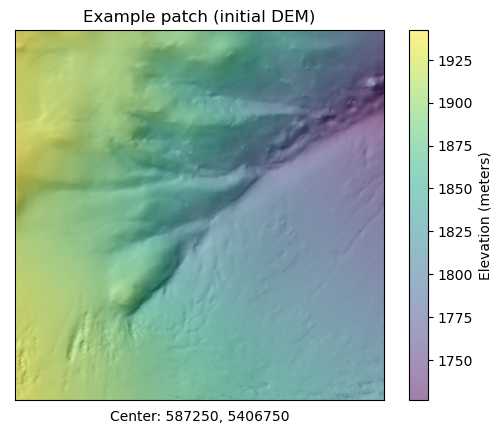

In [25]:
initial_dem_full = rioxarray.open_rasterio("mosaic/files_to_zip/WV01_20150911_1020010042D39D00_1020010043455300_aligned_crop_1.0m-DEM_holes_filled.tif").squeeze()
i,j = 4000,4000
TS = 500
initial_dem_small = initial_dem_full[i:i+TS,j:j+TS]
print(initial_dem_small.shape)
fig,ax = plt.subplots()
ax.imshow(hillshade(initial_dem_small), cmap="gray")
im = ax.imshow(initial_dem_small, cmap="viridis", alpha=0.5)
plt.colorbar(im, ax=ax, label="Elevation (meters)")
ax.set_xticks([])
ax.set_yticks([])
ax.set_title("Example patch (initial DEM)")

bounds = initial_dem_small.rio.bounds()
cx = (bounds[2] + bounds[0])/2
cy = (bounds[3] + bounds[1])/2
ax.set_xlabel(f"Center: {cx:.0f}, {cy:.0f}")

In [28]:
refined_v68_last = rioxarray.open_rasterio("inference_out_v68_epoch11325.tif")

In [29]:
refined_v68_middle = rioxarray.open_rasterio("inference_out_v68_epoch5086.tif")

In [32]:
refined_v68_middle.shape

(1, 16000, 8000)

In [30]:
diff_last_middle = refined_v68_last - refined_v68_middle

In [33]:
def get_tiles(raster,y,x,h=256,w=256):
    raster = raster.squeeze()
    return raster[y:y+h,x:x+h]

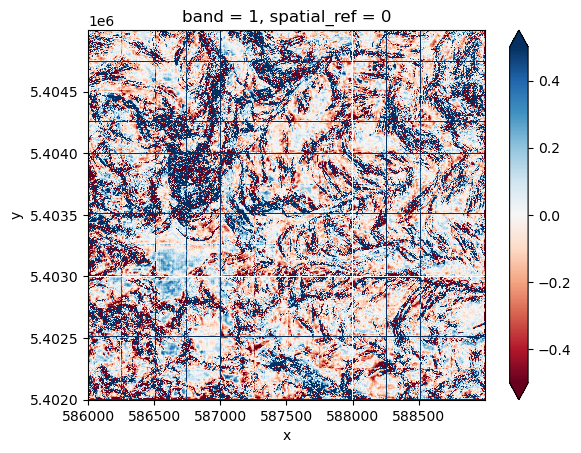

In [47]:
get_tile(diff_last_middle,6000,3000,h=3000,w=3000).plot(vmin=-0.5,vmax=0.5,cmap="RdBu")

## Inference breakdown by land cover type (started with NLCD classes, mask to keep only points in a given class)

In [50]:
nlcd = rioxarray.open_rasterio("nlcd2016_baker_32610.tif").rio.reproject_match(refined_v68_last).squeeze()

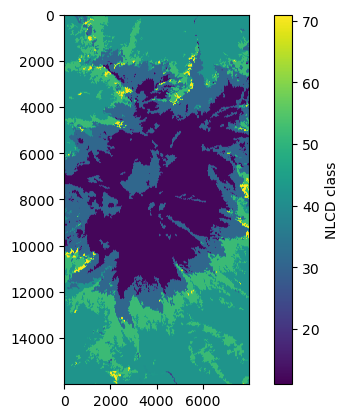

In [79]:
fig, ax = plt.subplots()
im = ax.imshow(nlcd)
ax.set_aspect(1)
plt.colorbar(im, label="NLCD class")

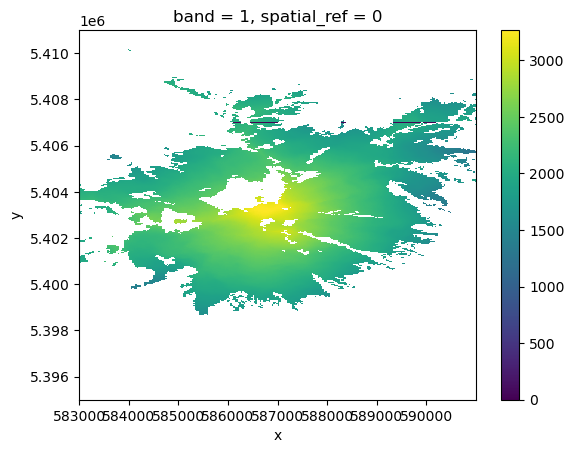

In [82]:
refined_v68_last.where(nlcd == 12).plot()

In [136]:
glacier_pixels = refined_v68_last.where((nlcd == 12) & (refined_v68_last != 0))

In [84]:
lidar_dsm = rioxarray.open_rasterio("mosaic/mosaic_full128_USGS_LPC_WA_MtBaker_2015_*_LAS_2017_32610_first_filt_v1.3_1.0m-DEM_holes_filled.tif")

In [130]:
(initial_dem_full - lidar_dsm).mean()

<xarray.DataArray ()>
array(1.14279, dtype=float32)
Coordinates:
    spatial_ref  int64 0

In [135]:
glacier_pixels_lidar = lidar_dsm.where((nlcd == 12) & (lidar_dsm != 0))

In [137]:
diff_glacier = (glacier_pixels - glacier_pixels_lidar).squeeze()

In [ ]:
plt.hist(diff_glacier.squeeze(), bins=20, vmin=-5, vmax=5)

In [99]:
type(diff_glacier)

xarray.core.dataarray.DataArray

In [103]:
scipy.stats.median_abs_deviation?

Signature:
scipy.stats.median_abs_deviation(
    x,
    axis=0,
    center=<function median at 0x7f386739e710>,
    scale=1.0,
    nan_policy='propagate',
)
Docstring:
Compute the median absolute deviation of the data along the given axis.

The median absolute deviation (MAD, [1]_) computes the median over the
absolute deviations from the median. It is a measure of dispersion
similar to the standard deviation but more robust to outliers [2]_.

The MAD of an empty array is ``np.nan``.

.. versionadded:: 1.5.0

Parameters
----------
x : array_like
    Input array or object that can be converted to an array.
axis : int or None, optional
    Axis along which the range is computed. Default is 0. If None, compute
    the MAD over the entire array.
center : callable, optional
    A function that will return the central value. The default is to use
    np.median. Any user defined function used will need to have the
    function signature ``func(arr, axis)``.
scale : scalar or str, optional
   

In [138]:
import scipy.stats
nmad = scipy.stats.median_abs_deviation(np.array(diff_glacier).reshape(-1), nan_policy="omit")

In [139]:
nmad

0.3280029296875

In [140]:
diff_glacier.min()

<xarray.DataArray ()>
array(-928.599, dtype=float32)
Coordinates:
    band         int64 1
    spatial_ref  int64 0

In [141]:
diff_glacier.max()

<xarray.DataArray ()>
array(77.41138, dtype=float32)
Coordinates:
    band         int64 1
    spatial_ref  int64 0

In [145]:
np.mean(np.abs(diff_glacier))

<xarray.DataArray ()>
array(0.8014106, dtype=float32)
Coordinates:
    band         int64 1
    spatial_ref  int64 0

In [143]:
diff_glacier.median()

<xarray.DataArray ()>
array(-0.05126953, dtype=float32)
Coordinates:
    band         int64 1
    spatial_ref  int64 0

In [90]:
diff_glacier.std()

<xarray.DataArray ()>
array(95.54814, dtype=float32)
Coordinates:
    spatial_ref  int64 0

In [77]:
import numpy as np
[(k,names[k]) for k in np.unique(nlcd)]

[(11, 'Open Water'),
 (12, 'Perennial Ice/Snow'),
 (21, 'Developed, Open Space'),
 (22, 'Developed, Low Intensity'),
 (23, 'Developed, Medium Intensity'),
 (24, 'Developed High Intensity'),
 (31, 'Barren Land (Rock/Sand/Clay)'),
 (41, 'Deciduous Forest'),
 (42, 'Evergreen Forest'),
 (43, 'Mixed Forest'),
 (52, 'Shrub/Scrub'),
 (71, 'Grassland/Herbaceous')]

In [61]:
# https://www.mrlc.gov/data/legends/national-land-cover-database-class-legend-and-description
descriptions = """
Class\ Value 	Classification Description
Water 	 
11 	Open Water- areas of open water, generally with less than 25% cover of vegetation or soil.
12 	Perennial Ice/Snow- areas characterized by a perennial cover of ice and/or snow, generally greater than 25% of total cover.
Developed 	 
21 	Developed, Open Space- areas with a mixture of some constructed materials, but mostly vegetation in the form of lawn grasses. Impervious surfaces account for less than 20% of total cover. These areas most commonly include large-lot single-family housing units, parks, golf courses, and vegetation planted in developed settings for recreation, erosion control, or aesthetic purposes.
22 	Developed, Low Intensity- areas with a mixture of constructed materials and vegetation. Impervious surfaces account for 20% to 49% percent of total cover. These areas most commonly include single-family housing units.
23 	Developed, Medium Intensity -areas with a mixture of constructed materials and vegetation. Impervious surfaces account for 50% to 79% of the total cover. These areas most commonly include single-family housing units.
24 	Developed High Intensity-highly developed areas where people reside or work in high numbers. Examples include apartment complexes, row houses and commercial/industrial. Impervious surfaces account for 80% to 100% of the total cover.
Barren 	 
31 	Barren Land (Rock/Sand/Clay) - areas of bedrock, desert pavement, scarps, talus, slides, volcanic material, glacial debris, sand dunes, strip mines, gravel pits and other accumulations of earthen material. Generally, vegetation accounts for less than 15% of total cover.
Forest 	 
41 	Deciduous Forest- areas dominated by trees generally greater than 5 meters tall, and greater than 20% of total vegetation cover. More than 75% of the tree species shed foliage simultaneously in response to seasonal change.
42 	Evergreen Forest- areas dominated by trees generally greater than 5 meters tall, and greater than 20% of total vegetation cover. More than 75% of the tree species maintain their leaves all year. Canopy is never without green foliage.
43 	Mixed Forest- areas dominated by trees generally greater than 5 meters tall, and greater than 20% of total vegetation cover. Neither deciduous nor evergreen species are greater than 75% of total tree cover.
Shrubland 	 
51 	Dwarf Scrub- Alaska only areas dominated by shrubs less than 20 centimeters tall with shrub canopy typically greater than 20% of total vegetation. This type is often co-associated with grasses, sedges, herbs, and non-vascular vegetation.
52 	Shrub/Scrub- areas dominated by shrubs; less than 5 meters tall with shrub canopy typically greater than 20% of total vegetation. This class includes true shrubs, young trees in an early successional stage or trees stunted from environmental conditions.
Herbaceous 	 
71 	Grassland/Herbaceous- areas dominated by gramanoid or herbaceous vegetation, generally greater than 80% of total vegetation. These areas are not subject to intensive management such as tilling, but can be utilized for grazing.
72 	Sedge/Herbaceous- Alaska only areas dominated by sedges and forbs, generally greater than 80% of total vegetation. This type can occur with significant other grasses or other grass like plants, and includes sedge tundra, and sedge tussock tundra.
73 	Lichens- Alaska only areas dominated by fruticose or foliose lichens generally greater than 80% of total vegetation.
74 	Moss- Alaska only areas dominated by mosses, generally greater than 80% of total vegetation.
Planted/Cultivated 	 
81 	Pasture/Hay-areas of grasses, legumes, or grass-legume mixtures planted for livestock grazing or the production of seed or hay crops, typically on a perennial cycle. Pasture/hay vegetation accounts for greater than 20% of total vegetation.
82 	Cultivated Crops -areas used for the production of annual crops, such as corn, soybeans, vegetables, tobacco, and cotton, and also perennial woody crops such as orchards and vineyards. Crop vegetation accounts for greater than 20% of total vegetation. This class also includes all land being actively tilled.
Wetlands 	 
90 	Woody Wetlands- areas where forest or shrubland vegetation accounts for greater than 20% of vegetative cover and the soil or substrate is periodically saturated with or covered with water.
95 	Emergent Herbaceous Wetlands- Areas where perennial herbaceous vegetation accounts for greater than 80% of vegetative cover and the soil or substrate is periodically saturated with or covered with water.
"""

In [111]:
bareground_subset_from_coregistration = rioxarray.open_rasterio("baker_2015_utm_m_5m_ref.tif", masked=True).rio.reproject_match(initial_dem_full)

TypeError: Invalid shape (1, 16000, 8000) for image data

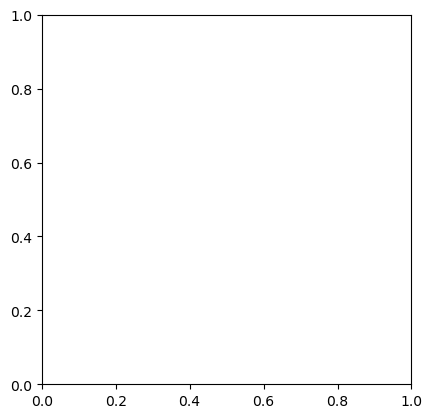

In [146]:
im = plt.imshow(bareground_subset_from_coregistration)

In [113]:
bare_mask = (bareground_subset_from_coregistration > 0)

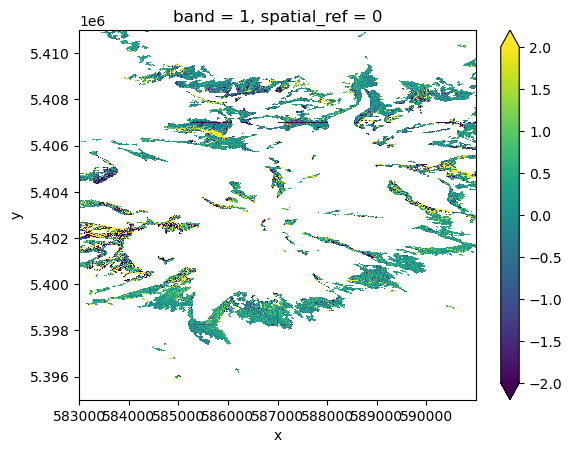

In [147]:
(refined_v68_last - lidar_dsm).where(bare_mask).plot(vmin=-2,vmax=2)

In [74]:
lines = [line.split("-")[0].split("\t") for line in descriptions.split("\n")]
names = {int(pair[0].strip()): pair[1].strip() for pair in lines if len(pair[0]) > 0 and pair[0][0].isnumeric()}
names

{11: 'Open Water',
 12: 'Perennial Ice/Snow',
 21: 'Developed, Open Space',
 22: 'Developed, Low Intensity',
 23: 'Developed, Medium Intensity',
 24: 'Developed High Intensity',
 31: 'Barren Land (Rock/Sand/Clay)',
 41: 'Deciduous Forest',
 42: 'Evergreen Forest',
 43: 'Mixed Forest',
 51: 'Dwarf Scrub',
 52: 'Shrub/Scrub',
 71: 'Grassland/Herbaceous',
 72: 'Sedge/Herbaceous',
 73: 'Lichens',
 74: 'Moss',
 81: 'Pasture/Hay',
 82: 'Cultivated Crops',
 90: 'Woody Wetlands',
 95: 'Emergent Herbaceous Wetlands'}

In [ ]:
# https://github.com/adehecq/ragmac_xdem/blob/amaury/notebooks/temporal_fitting_analysis.ipynb
# points = utils.extract_linestring_coords(flowline_gdf["geometry"].iloc[0])

xmin, ymin, xmax, ymax = initial_dem_small.rio.bounds()
cross_section_x = np.arange(xmin, xmax, 1)
cross_section_y = np.ones_like(cross_section_x) * (ymax+ymin)/2#np.arange(ymin, ymax, 10)

dems = [io.xr_read_geotif(f) for f in dem_files_list]
print(dems[0].dims)
ds = xarray.concat(dems, dim="time")

test_stack = utils.xr_extract_ma_arrays_at_coords(ds['band1'], points[0], points[1])
test_stack.shape # (8,115)

## Difference map shows melting between stereo + lidar collection times

In [127]:
clipped_diff = (initial_dem_full - lidar_dsm).rio.clip_box(585000, 5399000, 591000, 5405000)

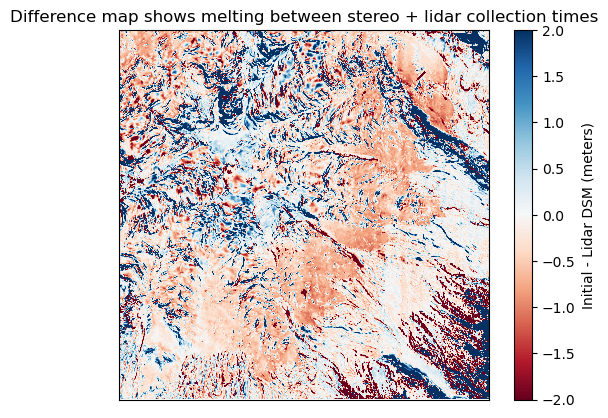

In [128]:
plt.imshow(clipped_diff, vmin=-2,vmax=2, cmap="RdBu")
plt.colorbar(label="Initial - Lidar DSM (meters)")
plt.title("Difference map shows melting between stereo + lidar collection times")
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gca().set_aspect(1)